In [1]:
import os
import joblib
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import numpy as np
import polars as pl
from warnings import simplefilter
import time
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly.offline import iplot
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import OneHotEncoder
# from sklearn.preprocessing import OneHotEncoding

simplefilter('ignore')
%matplotlib inline

# Data section
1. Summary statistics of demographics[Gender, Ethnicity, Age], All disposition, admitted vs discharged
2. Number of admitted orders for admitted patient and Number of admitted orders for discharged patients
3. Distribution of length of stay of admit/ted vs discharged patients
4. Distribution of Number of events of admitted vs discharged patients
4. Block diagram of the AI model

In [2]:
RAW_DATA = '/work/InternalMedicine/s223850/ED-StaticDynamic/raw_data/ED Events Last 2 Years - compiled 6.6.24.csv'
RAW_DATA_PAR = '/work/InternalMedicine/s223850/ED-StaticDynamic/raw_data/ED Events Last 2 Years - compiled 6.6.24.parquet'
RAW_TEST = '/work/InternalMedicine/s223850/ED-StaticDynamic/raw_data/latest_test.csv'
RAW_TEST_PAR = '/work/InternalMedicine/s223850/ED-StaticDynamic/raw_data/latest_test.parquet'
plotly_fig_template = 'seaborn'
plotly_fig_size = (1200, 600)

In [3]:

plotly_config = dict(
    title_font_size=32,
    title_font_family='Times New Roman',
    xaxis_title_font_size=32,
    xaxis_tickfont_size=16,
    xaxis_title_font_family='Times New Roman',
    yaxis_title_font_size=32,
    yaxis_tickfont_size=16,
    yaxis_title_font_family='Times New Roman',
    yaxis_range=[0.48, 0.85],
    width = 1300,
    height = 800,
    # dpi=120,
    template = 'seaborn'
)
    

In [4]:
### TEST CELL (DONT RUN)
# df = pl.read_csv(RAW_TEST,
#                 infer_schema_length=int(20e6),
#                 null_values='NULL',
#                 dtypes=dict(Patient_Age=pl.Float64))
# df.write_parquet(RAW_TEST_PAR)

In [5]:
# df = pl.read_csv(RAW_DATA,
#     infer_schema_length=int(20e6),
#     null_values='NULL',
#     dtypes=dict(Patient_Age=pl.Float64)
# )
df = pl.read_parquet(RAW_DATA_PAR)
# df.write_parquet('/work/InternalMedicine/s223850/ED-StaticDynamic/raw_data/ED Events Last 2 Years - compiled 6.6.24.parquet')

In [5]:
### Create a test raw data file for testing
all_pats = df['PAT_ENC_CSN_ID'].unique()
pats = np.random.choice(all_pats, int(len(all_pats)*0.05), replace=False)
df_sample = df.filter(pl.col('PAT_ENC_CSN_ID').is_in(pats))
len(df), len(df_sample)

(21553849, 1085551)

In [18]:
# df_sample.write_csv("/work/InternalMedicine/s223850/ED-StaticDynamic/raw_data/latest_test.csv")

In [5]:
df.columns

['PAT_ENC_CSN_ID',
 'PAT_MRN_ID',
 'PAT_ID',
 'Ethnicity',
 'FirstRace',
 'MultiRacial',
 'Sex',
 'Arrived_Time',
 'ED_Disposition',
 'Admitted_YN',
 'Patient_Age',
 'Acuity_Level',
 'Means_Of_Arrival',
 'Chief_Complaint',
 'Chief_Complaint_All',
 'Count_of_Chief_Complaints',
 'Calculated_DateTime',
 'Coverage_Financial_Class_Grouper',
 'Dispo_Prov_Admission_Rate',
 'ProblemList_Sixty_Admission_YN',
 'ProblemList_Eighty_Admission_YN',
 'Procedure in the Last 4 Weeks',
 'Has Completed Appt in Last Seven Days',
 'Has Hospital Encounter in Last Seven Days',
 'Number of Inpatient Admissions in the last 30 Days',
 'Number of past appointments in last 60 days',
 'Number of past inpatient admissions over ED visits in last three years',
 'Type',
 'EVENT_NAME',
 'ED_Location_YN',
 'Order_Status',
 'Result_Flag',
 'MEAS_VALUE',
 'Primary_DX_Name',
 'Primary_DX_First_ICD10',
 'Primary_DX_ICD10']

In [6]:
df = df.with_columns([
pl.col('Arrived_Time').str.strptime(pl.Datetime, "%Y-%m-%d %H:%M:%S%.f"),
pl.col('Calculated_DateTime').str.strptime(pl.Datetime, "%Y-%m-%d %H:%M:%S%.f")
]).sort(by=['Arrived_Time', 'Calculated_DateTime'])

In [7]:
df = df.with_columns([
    (pl.col('Calculated_DateTime')-pl.col('Arrived_Time')).dt.total_minutes().alias('LOS_min')
])

In [8]:
df.shape, df['PAT_MRN_ID'].n_unique(), df['PAT_ENC_CSN_ID'].n_unique(), df['Arrived_Time'].min(), df['Arrived_Time'].max()

((21553849, 37),
 67437,
 119766,
 datetime.datetime(2022, 6, 1, 0, 10),
 datetime.datetime(2024, 5, 30, 23, 43))

### Get the association frequency between events and disposition

In [9]:
df = df.with_columns(
    (pl.col("Type") == "Order - Admission").cumsum().over("PAT_ENC_CSN_ID").alias('n_admit_orders'),
    (pl.col("Type") == "Order - Discharge").cumsum().over("PAT_ENC_CSN_ID").alias('n_discharge_orders'),
)

In [21]:
df['ED_Disposition'].value_counts().sort(by='count', descending=True).to_pandas()

,ED_Disposition,count
0,Admitted,11078589
1,Discharged,9266394
2,AMA,402534
3,Pending Discharge,372384
4,Transfer to Another Facility,180223
5,Eloped,148481
6,LWBS,51522
7,Send to L&D,19547
8,Dismiss - Incorrect Chart,12318
9,Admit-Zale Lipshy,8968


In [67]:
# pats_with_admit_orders = df.filter( (pl.col("n_admit_orders")>=1)&( ~pl.col('ED_Disposition').is_in(['Discharged', 'Pending Discharge', 'Send to L&D', 'Dismiss - Incorrect Chart', 'LWBS', 'Eloped'])) )['PAT_ENC_CSN_ID'].unique()

In [15]:
df_target_filtered = df.filter(~pl.col('ED_Disposition').is_in(['Dismiss - Incorrect Chart', 'Send to L&D', 'LWBS']))

In [16]:
pats_with_admit_orders = df_target_filtered.filter(pl.col("n_admit_orders")>=1) ['PAT_ENC_CSN_ID'].unique()

In [17]:
len(pats_with_admit_orders)

44551

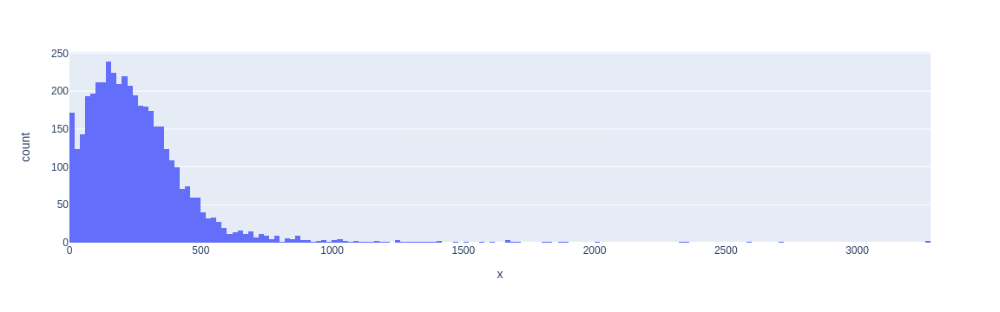

In [18]:
px.histogram(x=df_target_filtered.filter(pl.col('ED_Disposition')=='AMA').group_by('PAT_ENC_CSN_ID').agg(pl.col('LOS_min').max())['LOS_min'])

In [19]:
pats_with_no_admits = df_target_filtered.filter(
    (pl.col('n_admit_orders').sum().over('PAT_ENC_CSN_ID'))==0)['PAT_ENC_CSN_ID'].unique()

In [20]:
len(pats_with_no_admits), len(set(pats_with_no_admits))

(68263, 68263)

In [21]:
df_target_filtered.filter(pl.col("PAT_ENC_CSN_ID").is_in(pats_with_admit_orders)).group_by("PAT_ENC_CSN_ID").agg(pl.col("ED_Disposition").last())['ED_Disposition'].value_counts().sort(by='count', descending=True)

ED_Disposition,count
str,u32
"""Admitted""",43399
"""Discharged""",889
"""AMA""",173
"""Admit-Zale Lip…",45
"""Eloped""",18
"""Pending Discha…",14
"""Transfer to An…",9
"""Deceased""",4


In [22]:
df_target_filtered.filter(pl.col("PAT_ENC_CSN_ID").is_in(pats_with_no_admits)).group_by("PAT_ENC_CSN_ID").agg(pl.col("ED_Disposition").last())['ED_Disposition'].value_counts().sort(by='count', descending=True).to_pandas()

,ED_Disposition,count
0,Discharged,58102
1,AMA,4156
2,Eloped,2523
3,Pending Discharge,2293
4,Transfer to Another Facility,808
5,Admitted,345
6,Deceased,36


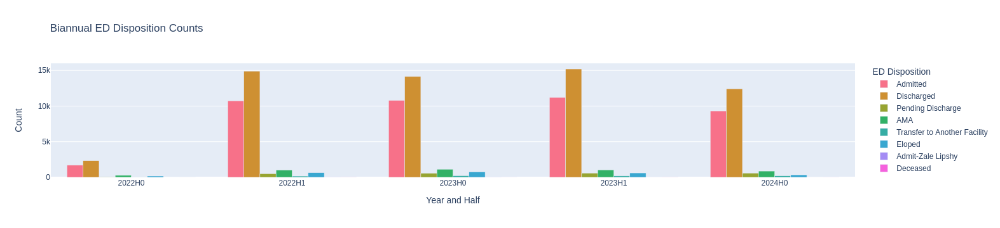

In [44]:
pat_year_ed = df_target_filtered.with_columns(
    [pl.col("Arrived_Time").dt.quarter().alias('quarter'),
     pl.col("Arrived_Time").dt.year().alias('year'),
    ]
).group_by('PAT_ENC_CSN_ID').agg([pl.col('quarter').last(), pl.col('year').last(), pl.col('ED_Disposition').last()]).sort(by=['year','quarter'])

# pat_year_ed['quarter'].value_counts()

pat_year_ed = pat_year_ed.with_columns( pl.when(pl.col('quarter')<=2).then(pl.lit(0)).otherwise(1).alias('biannual') )
pat_year_ed.group_by(['year', 'biannual', 'ED_Disposition']).agg(pl.col("PAT_ENC_CSN_ID").count()).sort(['year', 'biannual', 'ED_Disposition'])

# pat_year_ed_pivot = pat_year_ed.pivot(
pat_year_ed_pivot = pat_year_ed.pivot(
    values='PAT_ENC_CSN_ID',
    index=['year', 'biannual'],
    columns='ED_Disposition',
    aggregate_function='count'
).sort(['year', 'biannual']).fill_null(0)

fig = go.Figure()
dispos = [col for col in pat_year_ed_pivot.columns if col not in ['year', 'biannual'] ]
colors = sns.color_palette("husl", n_colors = len(dispos)).as_hex()

for disp, color in zip(dispos, colors):
    fig.add_trace(
        go.Bar(
            x=[f"{row['year']}H{row['biannual']}" for row in pat_year_ed_pivot.iter_rows(named=True)],
            y =pat_year_ed_pivot[disp],
            name=disp,
            marker_color=color
        )
    )

fig.update_layout(
        title='Biannual ED Disposition Counts',
        xaxis_title='Year and Half',
        yaxis_title='Count',
        barmode='group',
        legend_title='ED Disposition',
)

fig.show()

In [52]:
pat_year_ed.group_by(['year', 'quarter']).agg(pl.col("PAT_ENC_CSN_ID").count()).sort(['year', 'quarter'])

year,quarter,PAT_ENC_CSN_ID
i32,i8,u32
2022,2,4574
2022,3,14092
2022,4,13908
2023,1,13429
2023,2,14198
2023,3,14702
2023,4,14149
2024,1,14262
2024,2,9500


In [58]:
df_target_filtered.filter(pl.col('Type')=='Vitals').group_by('PAT_ENC_CSN_ID').agg(pl.col("EVENT_NAME").value_counts()).explode("EVENT_NAME")

PAT_ENC_CSN_ID,EVENT_NAME
i64,struct[2]
704658918,"{""SpO2"",6}"
704658918,"{""Resp"",6}"
704658918,"{""BP (MAP)"",2}"
704658918,"{""(0-10) Pain Rating: Rest"",2}"
704658918,"{""BMI (Calculated)"",1}"
…,…
672644210,"{""BP (MAP)"",3}"
672644210,"{""Resp"",1}"
672644210,"{""Pulse"",1}"


In [61]:
df_target_filtered.filter( (pl.col("PAT_ENC_CSN_ID")==704658918)&(pl.col("EVENT_NAME")=="SpO2") )[["Calculated_DateTime", "EVENT_NAME", "MEAS_VALUE"]]

Calculated_DateTime,EVENT_NAME,MEAS_VALUE
datetime[ns],str,f64
2024-05-28 11:34:00,"""SpO2""",96.0
2024-05-28 11:45:00,"""SpO2""",95.0
2024-05-28 12:09:00,"""SpO2""",94.0
2024-05-28 13:00:00,"""SpO2""",91.0
2024-05-28 13:15:00,"""SpO2""",95.0
2024-05-28 15:00:00,"""SpO2""",92.0


In [23]:
df_trim = df_target_filtered.filter(
    ((pl.col('n_admit_orders')<1)&(pl.col('n_discharge_orders')<1)).over('PAT_ENC_CSN_ID')
)

In [24]:
df_trim1 = df_target_filtered.with_columns(
    (pl.col('Type')=='Order - Admission').cum_sum().over('PAT_ENC_CSN_ID').alias('n_admit_orders'),
    ( (pl.col('Type')=='Order - Discharge')|(pl.col("EVENT_NAME").is_in([
            'AVS Printed',
            'Discharge AVS Print Snapshot',
            'Discharge Status Change',
            'FAM Discharge AVS Print Snapshot'
        ]))).cum_sum().over('PAT_ENC_CSN_ID').alias('n_disch_orders'),
).filter( (pl.col('n_admit_orders')<1) & (pl.col('n_disch_orders')<1) )

In [143]:
disch_event_counters = df_trim1.filter(pl.col("PAT_ENC_CSN_ID").is_in(pats_with_no_admits))["EVENT_NAME"].value_counts().sort(by='count', descending=True)

In [133]:
admit_event_counter = df_trim.filter(pl.col("PAT_ENC_CSN_ID").is_in(pats_with_admit_orders))["EVENT_NAME"].value_counts().sort(by='count', descending=True)

In [123]:
oneHundrendPercent_admit_association = admit_event_counter.filter(pl.col("count")>=len(pats_with_admit_orders))

In [148]:
oneHundrendPercent_discharge_association = disch_event_counters.filter(pl.col("count")>=len(pats_with_no_admits))

In [149]:
ONLY_ADMIT_EVENTS = set(oneHundrendPercent_admit_association['EVENT_NAME'].to_list()) - set(oneHundrendPercent_discharge_association['EVENT_NAME'].to_list())

In [150]:
ONLY_DISCH_EVENTS = set(oneHundrendPercent_discharge_association['EVENT_NAME'].to_list()) - set(oneHundrendPercent_admit_association['EVENT_NAME'].to_list())

In [152]:
ONLY_DISCH_EVENTS

set()

In [153]:
ONLY_ADMIT_EVENTS

{'BNP',
 'Consult tracking started',
 'GLUCOSE POC METER',
 'LACTATE (LACTIC ACID) SERUM',
 None,
 'XR CHEST 1 VIEW'}

In [142]:
df_trim.filter(df_trim['EVENT_NAME']=='XR CHEST 1 VIEW')['PAT_ENC_CSN_ID'].unique()

PAT_ENC_CSN_ID
i64
662909181
662909282
662909311
662910207
662910348
…
704862952
704863019
704863189


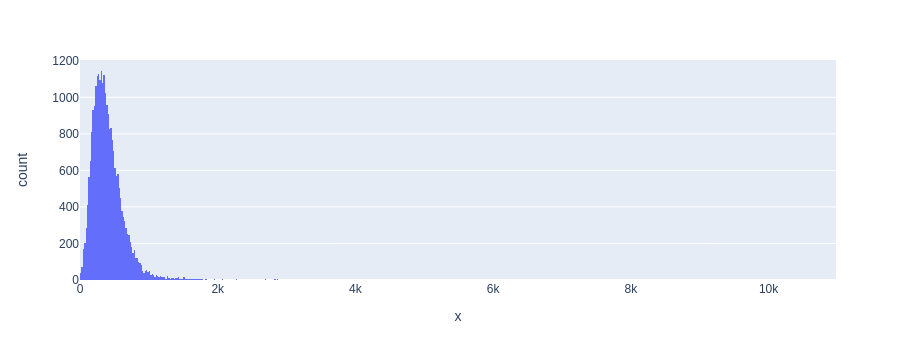

In [130]:
px.histogram(x = df_trim.filter(pl.col("PAT_ENC_CSN_ID").is_in(df_trim.filter(df_trim['EVENT_NAME']=='GLUCOSE POC METER')['PAT_ENC_CSN_ID'].unique())).group_by("PAT_ENC_CSN_ID").agg(pl.col("LOS_min").max())["LOS_min"])


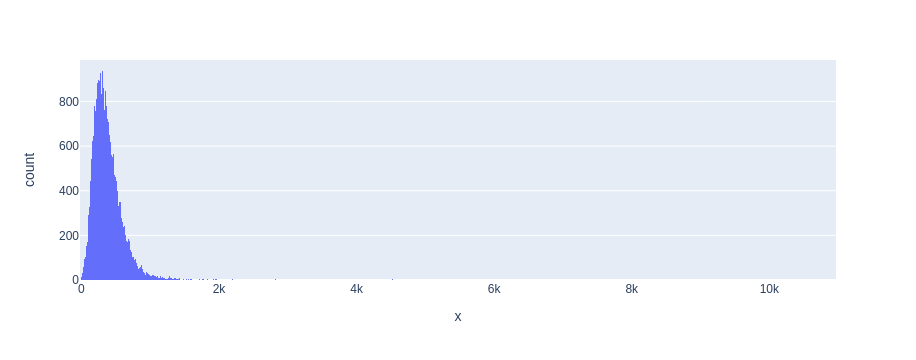

In [98]:
px.histogram(x = df_trim.filter(pl.col("PAT_ENC_CSN_ID").is_in(df_trim.filter(df_trim['EVENT_NAME']=='XR CHEST 1 VIEW')['PAT_ENC_CSN_ID'].unique())).group_by("PAT_ENC_CSN_ID").agg(pl.col("LOS_min").max())["LOS_min"])


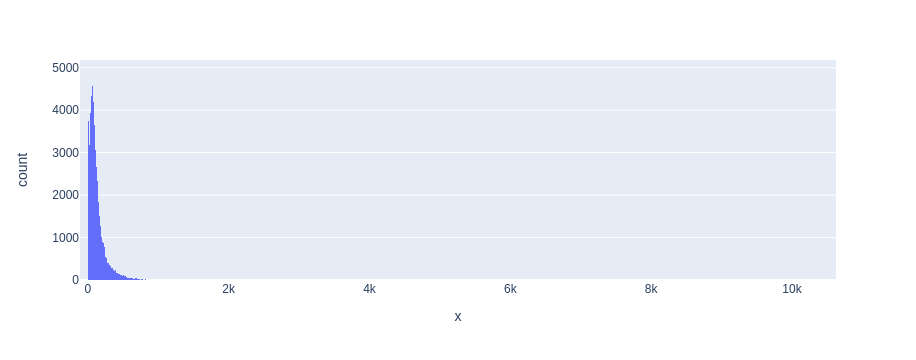

In [93]:
px.histogram(x=df_trim.filter(df_trim['EVENT_NAME']=='XR CHEST 1 VIEW')['LOS_min'])

In [31]:
# event_counters = df_trim.filter(pl.col("ED_Disposition").is_in(["Discharged", "Pending Discharge"])).group_by("PAT_ENC_CSN_ID").agg(pl.col("EVENT_NAME").value_counts()).explode("EVENT_NAME")

In [36]:
event_counters

PAT_ENC_CSN_ID,EVENT_NAME
i64,struct[2]
672523758,"{""BASOS PCT"",1}"
672523758,"{""Pulse"",3}"
672523758,"{""ED Note Pended"",2}"
672523758,"{""CALCIUM (ALBUMIN ADJUSTED)"",1}"
672523758,"{""BP (MAP)"",2}"
…,…
681574688,"{""MONOS ABS"",1}"
681574688,"{""PROTHROMBIN TIME + INR"",2}"
681574688,"{""KETONES, URINE"",1}"


In [60]:
event_counters.with_columns([pl.col("EVENT_NAME").struct.field("EVENT_NAME")])

PAT_ENC_CSN_ID,EVENT_NAME
i64,str
672523758,"""BASOS PCT"""
672523758,"""Pulse"""
672523758,"""ED Note Pended…"
672523758,"""CALCIUM (ALBUM…"
672523758,"""BP (MAP)"""
…,…
681574688,"""MONOS ABS"""
681574688,"""PROTHROMBIN TI…"
681574688,"""KETONES, URINE…"


In [47]:
pl.struct.__dir__()

['__new__',
 '__repr__',
 '__call__',
 '__get__',
 '__closure__',
 '__doc__',
 '__globals__',
 '__module__',
 '__builtins__',
 '__code__',
 '__defaults__',
 '__kwdefaults__',
 '__annotations__',
 '__dict__',
 '__name__',
 '__qualname__',
 '__hash__',
 '__str__',
 '__getattribute__',
 '__setattr__',
 '__delattr__',
 '__lt__',
 '__le__',
 '__eq__',
 '__ne__',
 '__gt__',
 '__ge__',
 '__init__',
 '__reduce_ex__',
 '__reduce__',
 '__subclasshook__',
 '__init_subclass__',
 '__format__',
 '__sizeof__',
 '__dir__',
 '__class__']

### Validating the regex use

In [7]:
all_events = df['EVENT_NAME'].unique().to_list()

In [22]:
len(all_events)

9432

In [19]:
import re
norm2all_dict = defaultdict(list)
for e in all_events:
    if e is None: continue
    norm_text = re.sub(r'[^a-zA-Z0-9_]+', '', e)
    norm2all_dict[norm_text].append(e)

In [20]:
for normv, origv in norm2all_dict.items():
    if len(origv)>1:
        print(normv,'=>',origv)

VITAMIND3ORAL => ['VITAMIN D3 ORAL', 'VITAMIN D-3 ORAL']
BILIRUBINBODYFLUID => ['BILIRUBIN, BODY FLUID', 'BILIRUBIN BODY FLUID']
GLUCOSEBODYFLUID => ['GLUCOSE, BODY FLUID', 'GLUCOSE BODY FLUID']
FACTORVIIIACTIVIYCHROMOGENIC => ['FACTOR VIII ACTIVIY CHROMOGENIC', 'FACTOR VIII ACTIVIY, CHROMOGENIC']
T3TOTAL => ['T3, TOTAL', 'T3 TOTAL']
MULTIVITAMINORAL => ['MULTIVITAMIN ORAL', 'MULTI VITAMIN ORAL']
IncisionandDrainage => ['Incision and Drainage ', 'Incision and Drainage']
SUPERBCOMPLEXORAL => ['SUPER B-COMPLEX ORAL', 'SUPER B COMPLEX ORAL']
ArterialLinePlacement => ['Arterial Line Placement ', 'Arterial Line Placement']
VITAMINB12ORAL => ['VITAMIN B12 ORAL', 'VITAMIN B-12 ORAL']
LDLDIRECT => ['LDL DIRECT', 'LDL, DIRECT']
CKMB => ['CKMB', 'CK MB']
OMEGA3ORAL => ['OMEGA-3 ORAL', 'OMEGA 3 ORAL']
VANCOMYCINIVPULSEDOSING => ['VANCOMYCIN IV PULSE DOSING', 'VANCOMYCIN IV PULSE DOSING ']
BCOMPLEXORAL => ['B COMPLEX ORAL', 'B-COMPLEX ORAL']
VITAMINB12 => ['VITAMIN B12', 'VITAMIN B-12']
ANAANTINUC

### Vital preprocessing and error handling

In [25]:
df.filter(pl.col('Type')=='Vitals')['EVENT_NAME'].unique().to_list()

['BMI (Calculated)',
 'Pulse',
 'BP',
 'Weight',
 '(0-10) Pain Rating: Activity',
 'Resp',
 'BSA (Dubois Calc)',
 '(0-10) Pain Rating: Rest',
 'Temp',
 'SpO2',
 'BP (MAP)']

In [36]:
df.filter(pl.col('EVENT_NAME')=='Pulse')['MEAS_VALUE'].max()

287.0

In [31]:
df.columns

['PAT_ENC_CSN_ID',
 'PAT_MRN_ID',
 'PAT_ID',
 'Ethnicity',
 'FirstRace',
 'MultiRacial',
 'Sex',
 'Arrived_Time',
 'ED_Disposition',
 'Admitted_YN',
 'Patient_Age',
 'Acuity_Level',
 'Means_Of_Arrival',
 'Chief_Complaint',
 'Chief_Complaint_All',
 'Count_of_Chief_Complaints',
 'Calculated_DateTime',
 'Coverage_Financial_Class_Grouper',
 'Dispo_Prov_Admission_Rate',
 'ProblemList_Sixty_Admission_YN',
 'ProblemList_Eighty_Admission_YN',
 'Procedure in the Last 4 Weeks',
 'Has Completed Appt in Last Seven Days',
 'Has Hospital Encounter in Last Seven Days',
 'Number of Inpatient Admissions in the last 30 Days',
 'Number of past appointments in last 60 days',
 'Number of past inpatient admissions over ED visits in last three years',
 'Type',
 'EVENT_NAME',
 'ED_Location_YN',
 'Order_Status',
 'Result_Flag',
 'MEAS_VALUE',
 'Primary_DX_Name',
 'Primary_DX_First_ICD10',
 'Primary_DX_ICD10']

In [19]:
dd = df['ED_Disposition'].value_counts().sort(by='count', descending=True).to_pandas()

In [21]:
dd['percentage'] = dd['count']/dd['count'].sum()

In [24]:
df.columns

['PAT_ENC_CSN_ID',
 'PAT_MRN_ID',
 'PAT_ID',
 'Ethnicity',
 'FirstRace',
 'MultiRacial',
 'Sex',
 'Arrived_Time',
 'ED_Disposition',
 'Admitted_YN',
 'Patient_Age',
 'Acuity_Level',
 'Means_Of_Arrival',
 'Chief_Complaint',
 'Chief_Complaint_All',
 'Count_of_Chief_Complaints',
 'Calculated_DateTime',
 'Coverage_Financial_Class_Grouper',
 'Dispo_Prov_Admission_Rate',
 'ProblemList_Sixty_Admission_YN',
 'ProblemList_Eighty_Admission_YN',
 'Procedure in the Last 4 Weeks',
 'Has Completed Appt in Last Seven Days',
 'Has Hospital Encounter in Last Seven Days',
 'Number of Inpatient Admissions in the last 30 Days',
 'Number of past appointments in last 60 days',
 'Number of past inpatient admissions over ED visits in last three years',
 'Type',
 'EVENT_NAME',
 'ED_Location_YN',
 'Order_Status',
 'Result_Flag',
 'MEAS_VALUE',
 'Primary_DX_Name',
 'Primary_DX_First_ICD10',
 'Primary_DX_ICD10']

In [33]:
var_dict = {
    'Patient-related':[
        'Ethnicity',
         'FirstRace',
         'MultiRacial',
         'Sex',
         'Arrived_Time',
         'Patient_Age',
         'Means_Of_Arrival',
         'Chief_Complaint_All',
         'Coverage_Financial_Class_Grouper',
         'ProblemList_Sixty_Admission_YN',
         'ProblemList_Eighty_Admission_YN',
         'Procedure in the Last 4 Weeks',
         'Has Completed Appt in Last Seven Days',
         'Has Hospital Encounter in Last Seven Days',
         'Number of Inpatient Admissions in the last 30 Days',
         'Number of past appointments in last 60 days',
         'Number of past inpatient admissions over ED visits in last three years',
    ],
    'ED-Events':[
         'Type',
         'EVENT_NAME',
         'ED_Location_YN',
         'Order_Status',
         'Result_Flag',
         'MEAS_VALUE',
         'Primary_DX_ICD10',
         'Acuity_Level',
    ],
    'Provider-related':
    ['Dispo_Prov_Admission_Rate']
}

In [34]:
all_vars = [v for v in var_dict.values()]
all_vars = [x for xs in all_vars for x in xs]

In [35]:
set(df.columns)-set(all_vars)

{'Admitted_YN',
 'Calculated_DateTime',
 'Chief_Complaint',
 'Count_of_Chief_Complaints',
 'ED_Disposition',
 'PAT_ENC_CSN_ID',
 'PAT_ID',
 'PAT_MRN_ID',
 'Primary_DX_First_ICD10',
 'Primary_DX_Name'}

In [37]:
df['Type'].n_unique()

12

In [40]:
df.group_by('Type').agg(pl.col("EVENT_NAME").n_unique()).sort(by='EVENT_NAME', descending=True).to_pandas()

,Type,EVENT_NAME
0,Order - Medication,6042
1,Order - Lab,809
2,Order - Imaging,672
3,Order Result - Lab,587
4,Event,508
5,Order - Nursing,455
6,Order Result - Imaging,386
7,Order - Procedures,216
8,Order - Consult,160
9,Vitals,11


In [8]:
df.columns

['PAT_ENC_CSN_ID',
 'PAT_MRN_ID',
 'PAT_ID',
 'Ethnicity',
 'FirstRace',
 'MultiRacial',
 'Sex',
 'Arrived_Time',
 'ED_Disposition',
 'Admitted_YN',
 'Patient_Age',
 'Acuity_Level',
 'Means_Of_Arrival',
 'Chief_Complaint',
 'Chief_Complaint_All',
 'Count_of_Chief_Complaints',
 'Calculated_DateTime',
 'Coverage_Financial_Class_Grouper',
 'Dispo_Prov_Admission_Rate',
 'ProblemList_Sixty_Admission_YN',
 'ProblemList_Eighty_Admission_YN',
 'Procedure in the Last 4 Weeks',
 'Has Completed Appt in Last Seven Days',
 'Has Hospital Encounter in Last Seven Days',
 'Number of Inpatient Admissions in the last 30 Days',
 'Number of past appointments in last 60 days',
 'Number of past inpatient admissions over ED visits in last three years',
 'Type',
 'EVENT_NAME',
 'ED_Location_YN',
 'Order_Status',
 'Result_Flag',
 'MEAS_VALUE',
 'Primary_DX_Name',
 'Primary_DX_First_ICD10',
 'Primary_DX_ICD10']

In [6]:
df = df.with_columns(
    [
        pl.col("Arrived_Time").last().over("PAT_ENC_CSN_ID").dt.year().alias('arr_year'),
        pl.col("Arrived_Time").last().over("PAT_ENC_CSN_ID").dt.quarter().alias('quarter'),
    ]
).with_columns(
    [
        (pl.col("arr_year").cast(pl.String) + '_' +pl.col("quarter").cast(pl.String)).alias("year_quat")
    ]
)

### Create a trimmed dataset

In [13]:
df = df.with_columns(
    [
        (pl.col("Type")=="Order - Admission").cumsum().over("PAT_ENC_CSN_ID").alias("n_admit_orders"),
        (pl.col("Type")=="Order - Discharge").cumsum().over("PAT_ENC_CSN_ID").alias("n_disch_orders"),
    ]
).with_columns(
    (pl.col("n_admit_orders")+pl.col("n_disch_orders")).alias("n_dispo_orders"),
)

In [14]:
df_trimmed = df.filter(pl.col('n_dispo_orders')<1)

In [16]:
df_trimmed = df_trimmed.with_columns( (pl.col('Calculated_DateTime')-pl.col('Arrived_Time')).dt.total_minutes().alias('len_stay_min') )

In [47]:
dd = df_trimmed.group_by('PAT_ENC_CSN_ID').agg(
    [
        pl.col('len_stay_min').last(),
        pl.col('ED_Disposition').last()
    ]
)

In [63]:
pats = dd.filter(pl.col('len_stay_min')>=880)['PAT_ENC_CSN_ID']
cc = df.filter(pl.col('PAT_ENC_CSN_ID').is_in(pats))['Chief_Complaint_All'].explode()

In [67]:
cc.value_counts().sort(by='count', descending=True).head(10).to_pandas()

,Chief_Complaint_All,count
0,ABDOMINAL PAIN,92255
1,PSYCHIATRIC EVALUATION,86351
2,SUICIDAL,63114
3,PSYCHIATRIC PROBLEM,49684
4,CHEST PAIN,39416
5,BREATHING PROBLEM,33690
6,OTHER,28343
7,HEADACHE,26394
8,EYE PROBLEM,17571
9,GENERALIZED WEAKNESS,17552


In [68]:
df['Chief_Complaint_All'].explode().value_counts().sort(by='count', descending=True).head(10)

Chief_Complaint_All,count
str,u32
"""ABDOMINAL PAIN…",2295900
"""BREATHING PROB…",1284803
"""CHEST PAIN""",1283194
"""GENERALIZED WE…",548978
"""FALLS""",529845
"""ABNORMAL TESTS…",523098
"""OTHER""",476526
"""HEADACHE""",414482
"""FEVER""",395490


In [48]:
dd = dd.filter(pl.col("ED_Disposition").is_in(["Admitted", "Discharged"]))

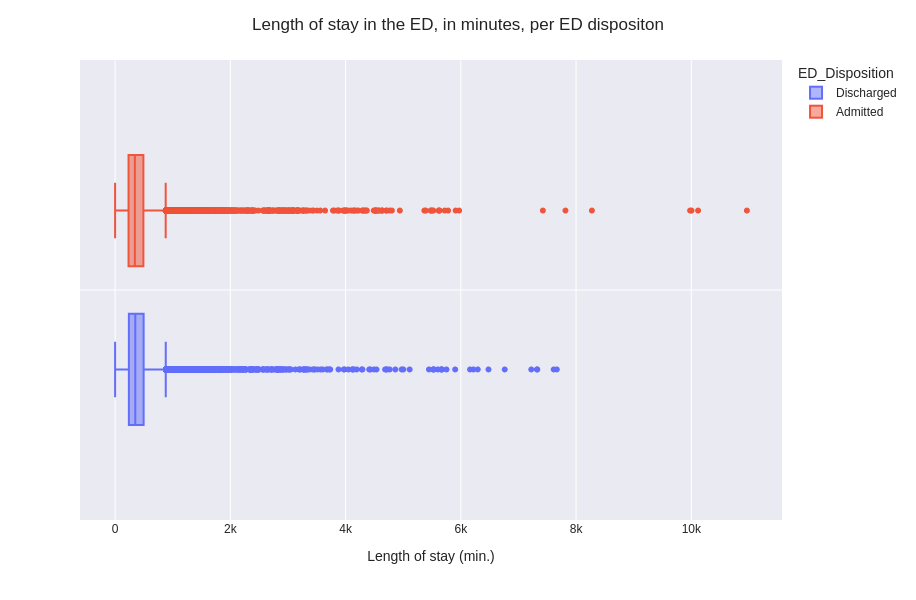

In [51]:
f = px.box(dd, x='len_stay_min', color='ED_Disposition')
f.update_layout(
    title_text='Length of stay in the ED, in minutes, per ED dispositon',
    xaxis_title='Length of stay (min.)',
    
    width = plotly_fig_size[0],
    height = plotly_fig_size[1],
    template = plotly_fig_template
)
f.show()

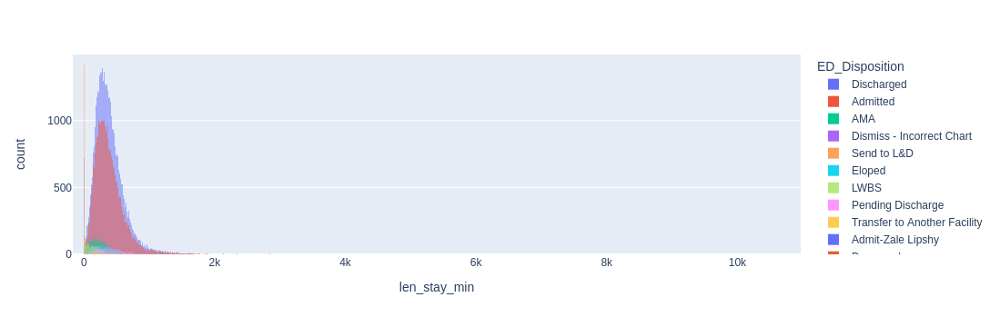

In [39]:
px.histogram(dd, x='len_stay_min', color='ED_Disposition', barmode='overlay')

In [41]:
dd_filter = dd.filter(pl.col('len_stay_min')<5_000)

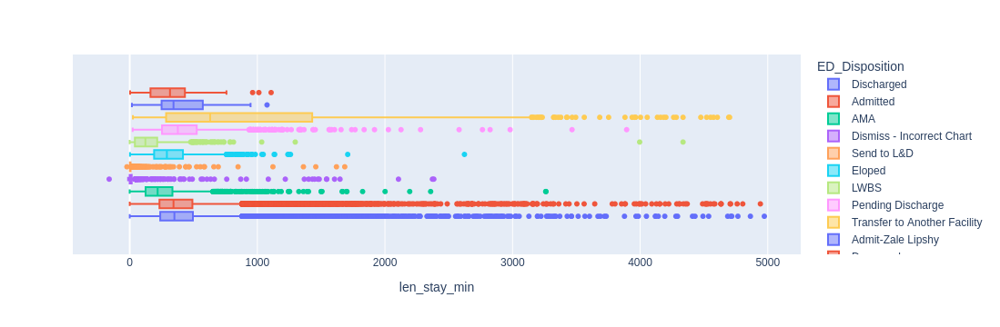

In [42]:
px.box(dd_filter, x='len_stay_min', color='ED_Disposition')

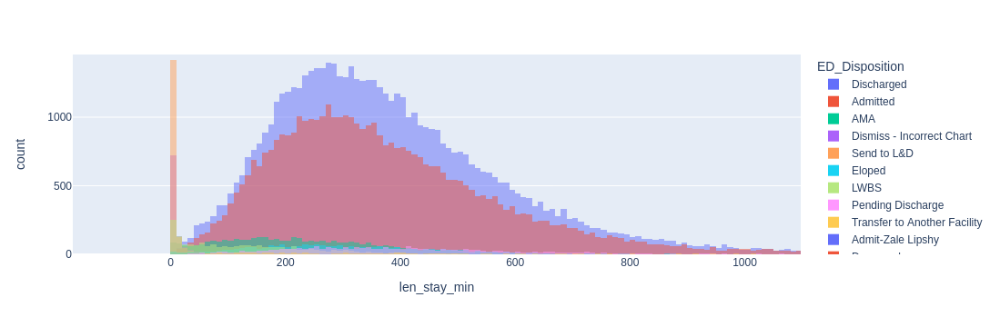

In [43]:
px.histogram(dd_filter, x='len_stay_min', color='ED_Disposition', barmode = 'overlay')

In [35]:
329/60

5.483333333333333

### Visualize the number of Order - Admission given to discharged patients

In [11]:
dff = df.filter(pl.col('ED_Disposition').is_in(['Discharged', 'Admitted']))

In [7]:
dff = dff.with_columns( (pl.col("Type")=="Order - Admission").cumsum().over("PAT_ENC_CSN_ID").alias("n_admit_orders") )

In [10]:
dff.filter( (pl.col("n_admit_orders")>=1)&(pl.col("ED_Disposition")=="Discharged" ))["PAT_ENC_CSN_ID"].n_unique()

889

In [12]:
dff.filter( (pl.col("n_admit_orders").last().over("PAT_ENC_CSN_ID")==0)&(pl.col("ED_Disposition")=="Admitted" ))["PAT_ENC_CSN_ID"].n_unique()

345

In [ ]:
dff.filter(pl.col("PAT_ENC_CSN_ID")==)["n_admit_orders"]

In [16]:
ddd_ev = dff.filter( (pl.col("ED_Disposition")=="Discharged") & (pl.col("Type")=="Event") )["EVENT_NAME"].value_counts().sort(by="count", descending=True)

In [38]:
dda_ev = dff.filter( (pl.col("ED_Disposition")=="Admitted") & (pl.col("Type")=="Event") )["EVENT_NAME"].value_counts().sort(by="count", descending=True)
dda_ev_trim = dff.filter( (pl.col("ED_Disposition")=="Admitted") & (pl.col("n_admit_orders")<1) & ((pl.col("Type")=="Event")))["EVENT_NAME"].value_counts().sort(by="count", descending=True)

In [24]:
dff.filter( (pl.col("ED_Disposition")=="Admitted") & (pl.col("Type")=="Event") )["PAT_ENC_CSN_ID"].n_unique()

43744

In [21]:
dff.filter( (pl.col("ED_Disposition")=="Discharged") & (pl.col("Type")=="Event") )["PAT_ENC_CSN_ID"].n_unique()

58991

In [23]:
ddd_ev.filter(pl.col("count") >= 58991).to_pandas()

,EVENT_NAME,count
0,Patient Moving,169741
1,Pt rounding completed,167063
2,Pt rounding timer started,167063
3,Re-assessment completed,129171
4,Re-assessment timer reset,129167
5,Lab Ordered,117568
6,Initial ED Provider Contact,113405
7,Assign Nurse,101317
8,ED Lactate Resulted,99157
9,Lab Resulted,87002


In [47]:
list(filter(lambda x: 'print' in x.lower(), dda_ev_trim["EVENT_NAME"].to_list()))

['Discharge AVS Print Snapshot',
 'AVS Printed',
 'FAM Discharge AVS Print Snapshot']

In [53]:
admi_pat_avs = dff.filter( (pl.col("ED_Disposition")=="Admitted") & (pl.col("n_admit_orders")<1) & ((pl.col("EVENT_NAME").is_in(['FAM Discharge AVS Print Snapshot', 'AVS Printed', 'Discharge AVS Print Snapshot']))))['PAT_ENC_CSN_ID'].unique()

In [57]:
Type_cntr = defaultdict(int)
for pat in admi_pat_avs:
    for row in dff.filter(pl.col("PAT_ENC_CSN_ID") == pat)["Type"].value_counts().iter_rows(named=True):
        Type_cntr[row['Type']] += 1
    

In [59]:
Type_cntr, len(admi_pat_avs)

(defaultdict(int,
             {'Vitals': 171,
              'Order - Consult': 115,
              'Event': 171,
              'Order Result - Lab': 168,
              'Order - Nursing': 171,
              'Order Result - Imaging': 139,
              'Order - Admission': 169,
              'Order - Lab': 170,
              'Order - Imaging': 151,
              'Order - Medication': 171,
              'Order - Discharge': 15,
              'Order - Procedures': 7}),
 171)

In [31]:
all_admit_pats_ = dda_ev.filter(pl.col('count')>=43744)["EVENT_NAME"].to_list()

In [32]:
all_disch_pats_events = ddd_ev.filter(pl.col("count") >= 58991)["EVENT_NAME"].to_list()

In [33]:
set(all_admit_pats_events)-set(all_disch_pats_events)

{'Admission Orders Reconciled',
 'Consult tracking started',
 'Patient Transport In Progress',
 'Remove Nurse'}

In [34]:
set(all_disch_pats_events)-set(all_admit_pats_events)

{'AVS Printed',
 'Admission FAM List Generated',
 'Admission Med List Generated',
 'Discharge AVS Print Snapshot',
 'Discharge Status Change',
 'FAM Discharge AVS Print Snapshot'}

In [39]:
all_admit_pats_events = dda_ev["EVENT_NAME"].to_list()
all_admit_pats_events_trim = dda_ev_trim["EVENT_NAME"].to_list()
all_disch_pats_events = ddd_ev["EVENT_NAME"].to_list()

In [36]:
set(all_admit_pats_events)-set(all_disch_pats_events)

{'Acknowledged Troponin Specimen Hemolyzed',
 'Admitted',
 'Appointment Scheduled',
 'Appointment Scheduled (Rescheduled)',
 'Arrived',
 'Arrived at admitting location',
 'BMT A Leukemia Consult Re-Called',
 'BMT Called',
 'Balloon Inflation',
 'Balloon Inserted',
 'Balloon Placed Across Lesion',
 'Balloon Removed',
 'CHF/VAD/Heart TX Admits Completed',
 'CHF/VAD/Heart TX Admits Re-Called',
 'CPR Ended',
 'CPR Started',
 'CUH Pulm/MICU COVID Admits Consult Called',
 'Cardiac Cath Team Called',
 'Cardiac Output Performed',
 'Cardio-thoracic Surgery Called',
 'Cardiology Admits Completed',
 'Cardiology Admits Recalled',
 'Cardiology Consults Recalled',
 'Catheter Advanced Across Lesion',
 'Catheter Exchanged',
 'Central Line Documented',
 'Code Partial',
 'Code Procedures Initiated',
 'Consult Ordered: CARDIAC CATH (STEMI PAGER)',
 'Consult Ordered: CONSULT CUH PULM/MICU COVID ADMITS',
 'Consult Ordered: HOSPITALIST FOR HOME HEALTH EVAL',
 'Consult Ordered: NEUROLOGY ZALE',
 'Department 

In [37]:
set(all_disch_pats_events)-set(all_admit_pats_events)

{'Anesthesiology Recalled',
 'BMT Re-Called',
 'Biopsy Device Inserted',
 'Biopsy Device Removed',
 'Burn Consult Called',
 'Burn Consult Ordered',
 'CUH COVID ID Provider Review -1st Call',
 'Consult Ordered: CUH COVID ID PROVIDER REVIEW- 1ST CALL',
 'Endocrinology Consult Re-Called',
 'First Provider Evaluation',
 'Hand in ED',
 'LEFT LAB CHAIR',
 'Language Translator in ED',
 'Ophthalmology Consult Complete',
 'Oral Surgery Re-Called',
 'Pain Mgmt Consult Re-Called',
 'Patient Ready for Procedure',
 'Physical Therapy Consult Completed',
 'Radiation at 5000 mGy',
 'Specimen Sent to Lab',
 'Stroke Neurologist Re-called',
 'Toxicology Re-Called'}

In [40]:
set(all_admit_pats_events_trim)-set(all_disch_pats_events)

{'Arrived',
 'BMT A Leukemia Consult Re-Called',
 'BMT Called',
 'Balloon Inflation',
 'Balloon Inserted',
 'Balloon Placed Across Lesion',
 'Balloon Removed',
 'CHF/VAD/Heart TX Admits Re-Called',
 'CPR Started',
 'CUH Pulm/MICU COVID Admits Consult Called',
 'Cardiac Cath Team Called',
 'Cardiac Output Performed',
 'Cardio-thoracic Surgery Called',
 'Cardiology Admits Recalled',
 'Cardiology Consults Recalled',
 'Catheter Exchanged',
 'Code Partial',
 'Code Procedures Initiated',
 'Consult Ordered: CARDIAC CATH (STEMI PAGER)',
 'Consult Ordered: CONSULT CUH PULM/MICU COVID ADMITS',
 'Diabetic Limb Salvage Service Consult Re-Called',
 'Drainage Catheter Secured',
 'ED RN Deficiency Updated',
 'ED Stroke Thrombolytic Therapy Given',
 'GI Biliary Consult Re-Called',
 'GI Consult Re-Called',
 'GI Re-Called',
 'Hospitalist Re-Called',
 'IABP Insertion',
 'IABP Placement Verified',
 'IABP Settings',
 'IVUS',
 'In Lab Chair',
 'Infection Controlled Called',
 'Intubated',
 'Neurosurgery Zale

In [41]:
set(all_disch_pats_events)-set(all_admit_pats_events_trim)

{'Anesthesiology Recalled',
 'BMT Re-Called',
 'Benign Gynecology Consult Re-Called',
 'Biopsy Device Inserted',
 'Biopsy Device Removed',
 'Burn Consult Called',
 'Burn Consult Ordered',
 'CUH COVID ID Provider Review -1st Call',
 'Consult Ordered: CUH COVID ID PROVIDER REVIEW- 1ST CALL',
 'Consult Ordered: PRIVATE PHYSICIAN-ADD NAME IN COMMENTS',
 'ED to OBS Order Placed',
 'ENT Re-Called',
 'Endocrinology Consult Re-Called',
 'First Provider Evaluation',
 'Hand Re-Called',
 'Hand in ED',
 'Infectious Diseases Transplant Consult Called',
 'Infectious Diseases Transplant Consult Ordered',
 'Interventional Radiology Consult Re-Called',
 'LEFT LAB CHAIR',
 'Language Translator in ED',
 'Left Fast Track Chair',
 'Liver Transplant Consult Re-Called',
 'Neuro Re-Called',
 'Ophthalmology Consult Complete',
 'Oral Surgery Re-Called',
 'Orthopedics Spine Consult Re-Called',
 'Pain Mgmt Consult Re-Called',
 'Patient Ready for Procedure',
 'Patient Transferred Out of L&D',
 'Physical Therapy Co

### Plot Sex and Age distribution per quarter

In [46]:
dd = dff.group_by("PAT_ENC_CSN_ID").agg(
    [
        pl.col("year_quat").last(),
        pl.col('Patient_Age').last(),
        pl.col("Sex").last(),
        pl.col('ED_Disposition').last()
    ])

In [110]:
d_sex_ed_admi = dd.group_by(["year_quat", "Sex", "ED_Disposition"]).agg(pl.count("PAT_ENC_CSN_ID").alias("count")).pivot(values="count", index="year_quat", columns=["Sex", "ED_Disposition"], aggregate_function="sum").sort("year_quat").fill_null(0)

In [120]:
d_sex_ed_admi.columns[1][1:-1].split(",")[1][1:-1]

'Discharged'

In [107]:
de = dd.group_by('year_quat').agg([pl.col('Sex').value_counts()]).sort(by="year_quat").explode("Sex").unnest("Sex").pivot(columns="Sex", index="year_quat", values="count")

In [78]:
for c in de.columns:
    de = de.with_columns(pl.col(c).fill_null(0))

In [79]:
de

year_quat,Female,Male,Unknown
str,u32,u32,u32
"""2022_2""",2246,1788,1
"""2022_3""",7242,5533,0
"""2022_4""",7276,5581,1
"""2023_1""",6628,5315,0
"""2023_2""",7326,5667,0
"""2023_3""",7513,5851,1
"""2023_4""",7152,5878,1
"""2024_1""",7309,5752,0
"""2024_2""",4759,3915,0


In [85]:
df_long = de.with_columns(
    [
        pl.col("year_quat").apply(lambda x: x.split("_")[0]).alias("year"),
        pl.col("year_quat").apply(lambda x: x.split("_")[1]).alias("quarter")
    ]
).melt(id_vars=["year", "quarter"], value_vars=["Female", "Male", "Unknown"]).sort(["year", "quarter"])

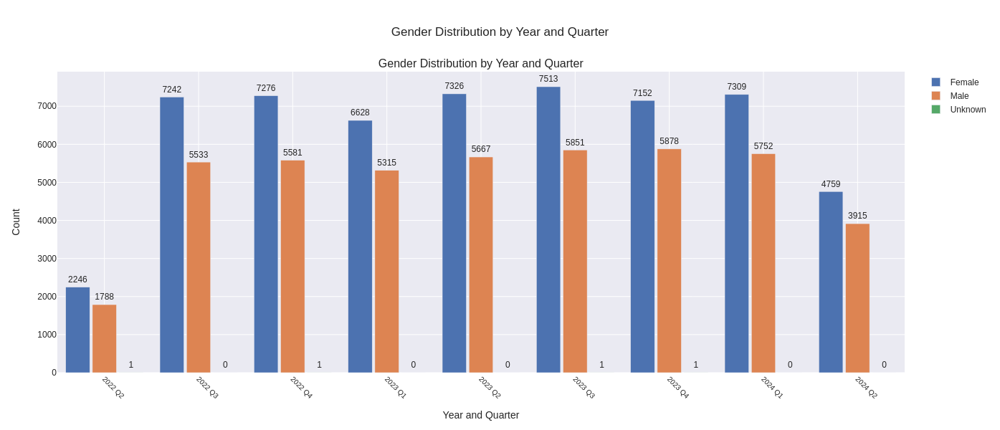

In [98]:

# Create the plot
fig = make_subplots(rows=1, cols=1, subplot_titles=['Gender Distribution by Year and Quarter'])

categories = ['Female', 'Male', 'Unknown']
colors = sns.color_palette("deep", n_colors=len(categories)).as_hex()

for i, category in enumerate(categories):
    data = df_long.filter(pl.col('variable') == category)
    
    fig.add_trace(
        go.Bar(
            x=[f"{row['year']}_{row['quarter']}" for row in data.to_dicts()],
            y=data['value'],
            name=category,
            text=data['value'],
            textposition='outside',
            marker_color=colors[i]
        )
    )



# Update x-axis to show years and quarters
all_ticks = df_long.select(['year', 'quarter']).unique().sort(['year', 'quarter'])
tick_vals = [f"{row['year']}_{row['quarter']}" for row in all_ticks.to_dicts()]
tick_text = [f"{row['year']} Q{row['quarter']}" for row in all_ticks.to_dicts()]

fig.update_xaxes(
    tickvals=tick_vals,
    ticktext=tick_text,
    tickangle=45,
    tickfont=dict(size=10)
)

fig.update_layout(
        title_text='Gender Distribution by Year and Quarter',
    xaxis_title='Year and Quarter',
    yaxis_title='Count',
    barmode='group',
    bargap=0.15,
    bargroupgap=0.1,
    width = plotly_fig_size[0],
    height = plotly_fig_size[1],
    template = plotly_fig_template
)
fig.show()

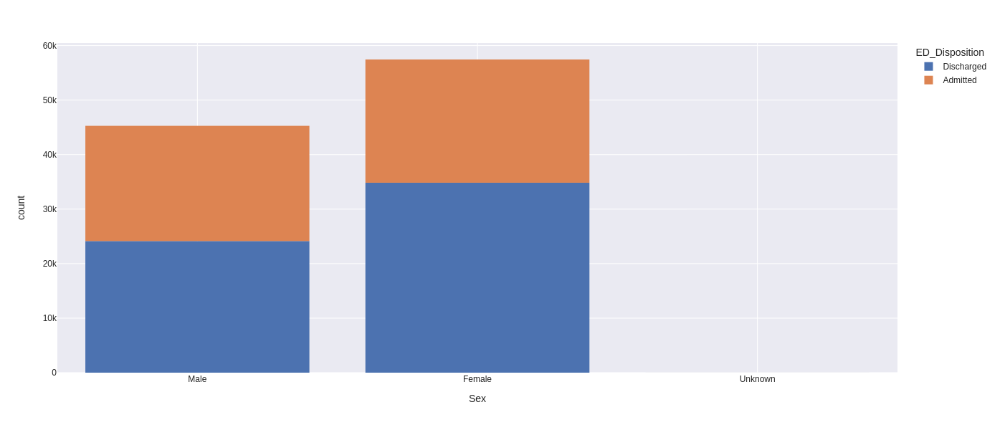

In [40]:
px.histogram(data_frame=dd, x='Sex', color='ED_Disposition',
             template=plotly_fig_template, width=plotly_fig_size[0], height=plotly_fig_size[1])

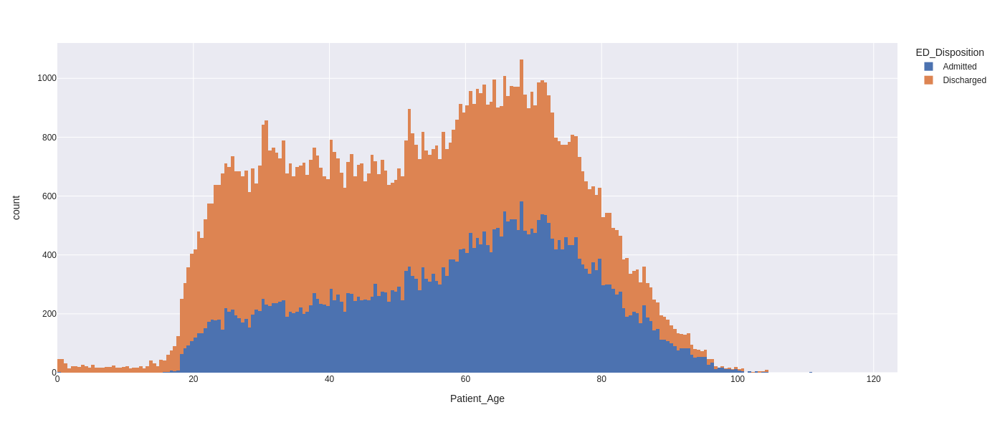

In [25]:
px.histogram(data_frame=dd, x='Patient_Age', color='ED_Disposition',
             template=plotly_fig_template, width=plotly_fig_size[0], height=plotly_fig_size[1])

### Average length of stay in the ED

In [6]:
df['Calculated_DateTime']

Calculated_DateTime
str
"""2022-06-01 00:…"
"""2022-06-01 00:…"
"""2022-06-01 00:…"
"""2022-06-01 00:…"
"""2022-06-01 00:…"
…
"""2024-05-31 02:…"
"""2024-05-31 02:…"
"""2024-05-31 02:…"


In [5]:
df = df.with_columns(
    (pl.col('Calculated_DateTime')-pl.col('Arrived_Time')).dt.total_minutes().alias('len_stay_min')
)

In [6]:
dd = df.group_by('PAT_ENC_CSN_ID').agg(pl.col('len_stay_min').last())

In [7]:
fig = px.histogram(data_frame=dd, x='len_stay_min')

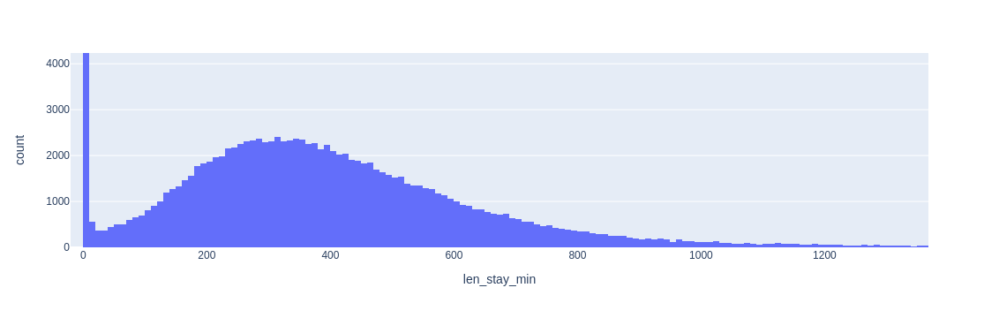

In [8]:
fig.show()

# Analysis results

## FS

In [10]:
FS_DIR = "/work/InternalMedicine/s223850/ED-StaticDynamic/fs_results/Clean_V1_OHE_ALL/"

In [11]:
fs_models = os.listdir(FS_DIR)

In [12]:
fs_models

['results_1950_2880.joblib',
 'results_1470_1920.joblib',
 'results_30_720.joblib',
 'results_750_1440.joblib']

In [13]:
with open(os.path.join(FS_DIR, fs_models[2]), 'rb') as f:
    data0 = joblib.load(f)
with open(os.path.join(FS_DIR, fs_models[3]), 'rb') as f:
    data1 = joblib.load(f)
with open(os.path.join(FS_DIR, fs_models[1]), 'rb') as f:
    data2 = joblib.load(f)

In [14]:
data0.keys()

dict_keys(['lsvm_score_list', 'rf_score_list', 'cat_score_list', 'lg_score_list', 'xgb_score_list', 'train_indices', 'test_indices', 'time_idx'])

In [14]:
data0['cat_score_list'][0]['static_model'].estimator_.feature_importances_, data0['time_idx'][-1]

(array([1.54268187e+00, 6.26774801e-01, 1.13117499e+00, 4.29893098e-02,
        8.45074071e+00, 4.01253188e+00, 3.43296683e+00, 3.46215082e-01,
        1.76747870e-02, 7.01005327e-02, 2.32764966e-02, 3.35026538e-01,
        1.87368840e-01, 5.40059651e-01, 7.87109134e-01, 1.77247060e-01,
        1.38942235e-02, 1.00248881e-02, 9.39307298e-02, 4.67210847e-01,
        5.64254738e-01, 1.63342724e+00, 3.54555631e+00, 1.35251323e+01,
        3.33782448e+00, 1.00580748e+00, 2.78818255e-01, 2.87138047e-02,
        3.07932268e-02, 1.87832509e-01, 1.71566107e+00, 5.39032636e-02,
        7.18798009e-02, 6.39626064e-01, 4.84488604e-02, 9.56551401e-02,
        9.82460902e-02, 5.33731633e-02, 2.65703196e-01, 1.86679616e-01,
        1.04064037e+00, 2.61393179e-02, 4.91218146e-02, 2.00711727e-01,
        2.84448992e-01, 2.44087781e-01, 1.59544344e-01, 1.02211170e-01,
        1.61035662e-01, 9.93509774e-02, 1.73799521e-01, 9.37638280e-02,
        6.54694101e-02, 3.02166209e-02, 1.10780861e-01, 2.092042

In [70]:
jupyter nbextension enable --py widgetsnbextension --sys-prefix
# Plot Accuracy vs feats selected
model_key = 'lg_score_list'
feat_type = 'comb'
tidx = data0['time_idx']

for feat_type in ['comb', 'static', 'dynamic']:
    for model_key in ['lg_score_list', 'cat_score_list']:
        for i in range(3):
            print(f'Processing {model_key}_{feat_type}_2hrs_{i} ...')
            lg_models_list = data0[model_key]
            cidx = 3+i*len(tidx)
            
            model_dict = lg_models_list[cidx]
            static_input_feats = len(model_dict['static_feats'])
            dynamic_input_feats = len(model_dict['dynamic_feats'])
            comb_input_feats = len(model_dict['comb_feats'])
            
            y = data0[model_key][cidx][f'{feat_type}_model'].cv_results_['mean_test_score']
            
            feats_n_list = np.arange(len(data0[model_key][cidx][f'{feat_type}_feats']), -data0[model_key][cidx][f'{feat_type}_model'].step+1,
                                     -data0[model_key][cidx][f'{feat_type}_model'].step)
            if feats_n_list[-1] <= 0:
                feats_n_list[-1] = 1
            x = list(map(lambda x: str(x), feats_n_list[::-1]))
            
            
            arr_min = df.filter(pl.col('PAT_ENC_CSN_ID').is_in(lg_models_list[cidx]['train_pat_id']))['Arrived_Time'].min().date()
            arr_max = df.filter(pl.col('PAT_ENC_CSN_ID').is_in(lg_models_list[cidx]['train_pat_id']))['Arrived_Time'].max().date()
            
            
            fig = px.line(x=x, y=y)
            x_peak = np.argmax(y)
            fig.add_shape(
                type="line",
                x0=x_peak,
                x1=x_peak,
                y0=np.min(y)-0.02*np.min(y),  # Set the vertical line from min y to max y
                y1=np.max(y)+0.02*np.max(y),
                line=dict(color="red", width=2)
            )
            
            
            plotly_config = dict(
                title_font_size=32,
                title_font_family='Times New Roman',
                xaxis_title_font_size=32,
                xaxis_tickfont_size=16,
                xaxis_title_font_family='Times New Roman',
                yaxis_title_font_size=32,
                yaxis_tickfont_size=16,
                yaxis_title_font_family='Times New Roman',
                yaxis_range=[0.48, 0.85],
                width = 1300,
                height = 800,
                # dpi=120,
                template = 'seaborn'
            )
                
            
            fig = fig.update_layout(
                **plotly_config,
                title_text=f'<b>Encounters arrived between {arr_min} to {arr_max}</b>',
                xaxis_title='<b>Number of Selected Features</b>',
                yaxis_title='<b>Balanced Accuracy Score</b>',
                # title_font_color='color',
                # title_font_family='Times New Roman
                # width = plotly_fig_size[0],
                # height = plotly_fig_size[1],
                # template = plotly_fig_template
            )
            print(f'Writing image {model_key}_{feat_type}_2hrs_{i}.png ...')

            fig.write_image(f'./{model_key}_{feat_type}_2hrs_{i}.png')
    # fig.show()


Processing lg_score_list_comb_2hrs_0 ...
Writing image lg_score_list_comb_2hrs_0.png ...
Processing lg_score_list_comb_2hrs_1 ...
Writing image lg_score_list_comb_2hrs_1.png ...
Processing lg_score_list_comb_2hrs_2 ...
Writing image lg_score_list_comb_2hrs_2.png ...
Processing cat_score_list_comb_2hrs_0 ...
Writing image cat_score_list_comb_2hrs_0.png ...
Processing cat_score_list_comb_2hrs_1 ...
Writing image cat_score_list_comb_2hrs_1.png ...
Processing cat_score_list_comb_2hrs_2 ...
Writing image cat_score_list_comb_2hrs_2.png ...
Processing lg_score_list_static_2hrs_0 ...
Writing image lg_score_list_static_2hrs_0.png ...
Processing lg_score_list_static_2hrs_1 ...
Writing image lg_score_list_static_2hrs_1.png ...
Processing lg_score_list_static_2hrs_2 ...
Writing image lg_score_list_static_2hrs_2.png ...
Processing cat_score_list_static_2hrs_0 ...
Writing image cat_score_list_static_2hrs_0.png ...
Processing cat_score_list_static_2hrs_1 ...
Writing image cat_score_list_static_2hrs_1

In [35]:
'''
For the 3 folds, get the top 50 feats weighted with their importance, add their importance all together and reorder them. 
View the top 10 in the paper and add the rest in an index
Do that for static, dynamic, and static vs dynamic
Show how their importance change over folds
Do it for every 30 miuntes and then see if I need to aggregate.
'''
model_key = 'lg_score_list'
feat_type = 'static'
tidx = data0['time_idx']
feats_weights_list = []
base = 3

for i in range(3):
    print(f'Processing {model_key}_{feat_type}_2hrs_{i} ...')
    model_list = data0[model_key]
    cidx = base+i*len(tidx)
    
    model_dict = model_list[cidx]
    
    static_input_feats = model_dict[f'{feat_type}_feats']
    selected_idx = model_dict[f'{feat_type}_model'].support_
    
    try:
        model_weights = model_dict[f'{feat_type}_model'].estimator_.coef_
    except Exception as e:
        model_weights = model_dict[f'{feat_type}_model'].estimator_.feature_importances_
        
    in_cols = np.array(static_input_feats)
    selected_feats = in_cols[selected_idx]
    feats_weights = pd.DataFrame(model_weights.reshape(1, -1), columns=selected_feats).T.sort_values(by=0, ascending=False)
    feats_weights['abs_weight'] = feats_weights[0].abs()
    feats_weights = feats_weights.rename(columns={0:'weights'})
    feats_weights_list.append(feats_weights)


fwt = feats_weights_list[0].copy()

for f in feats_weights_list[1:]:
    fwt += f.copy()


for idx, row in fwt.iterrows():
    if np.isnan(row['weights']):
        v = 0
        if row.name in feats_weights_list[0].index:
            v += feats_weights_list[0].loc[row.name, 'weights']
        if row.name in feats_weights_list[1].index:
            v += feats_weights_list[1].loc[row.name, 'weights']
        if row.name in feats_weights_list[2].index:
            v += feats_weights_list[2].loc[row.name, 'weights']
        fwt.loc[row.name] = [v, abs(v)]

fwt = fwt.sort_values(by='abs_weight', ascending=False)
fwt.to_csv('static_lg_2hrs_overAll6mthsfols.csv')

Processing lg_score_list_static_2hrs_0 ...
Processing lg_score_list_static_2hrs_1 ...
Processing lg_score_list_static_2hrs_2 ...


,weights,abs_weight
Acuity_Level_IV,-8.255981,8.255981
Acuity_Level_I,4.617011,4.617011
cc_list_motorvehiclecrash,-3.799848,3.799848
Acuity_Level_null,3.646452,3.646452
Acuity_Level_V,-3.587072,3.587072
...,...,...
cc_list_ribinjury,0.002473,0.002473
Sex_*Unspecified,-0.001285,0.001285
cc_list_abdominaldistention,0.001019,0.001019
cc_list_bladderspasms,0.000302,0.000302


In [97]:
common_set = set()
for idx in range(len(static_lg_output)):
    len_original_feats = len(static_lg_output[idx]['input_feats'])
    selected_feats = static_lg_output[idx]['feats_weights']
    ED_time, start_time_tr, end_time_tr = static_lg_output[idx]['tidx'], static_lg_output[idx]['start_tr'], static_lg_output[idx]['end_tr']
    if len(common_set) == 0:
        common_set = set(selected_feats[:50].index)
    else:
        common_set.intersection(set(selected_feats[:50].index))
    # print(len_original_feats, selected_feats[:50].index, ED_time, start_time_tr, end_time_tr)
common_set

{'Acuity_Level_I',
 'Acuity_Level_II',
 'Acuity_Level_IV',
 'Acuity_Level_V',
 'Ethnicity_American Indian or Alaska Native',
 'Means_Of_Arrival_Fixed Wing',
 'Means_Of_Arrival_Helicopter',
 'Means_Of_Arrival_Police',
 'Means_Of_Arrival_Public Transportation',
 'cc_list_abdominalswelling',
 'cc_list_abnormallabwork',
 'cc_list_alcoholintoxication',
 'cc_list_alteredmentalstatus',
 'cc_list_anemia',
 'cc_list_appetiteproblem',
 'cc_list_assaultvictim',
 'cc_list_bladderpain',
 'cc_list_breastproblem',
 'cc_list_breastredness/rash/heat/swelling',
 'cc_list_buttoxpain',
 'cc_list_cysts',
 'cc_list_difficultywalking',
 'cc_list_earproblem',
 'cc_list_failuretothrive',
 'cc_list_gaitabnormality',
 'cc_list_gunshotwound',
 'cc_list_handinjury',
 'cc_list_headinjury',
 'cc_list_hearingproblem',
 'cc_list_heatexposure',
 'cc_list_hematemesis',
 'cc_list_hemodialysisaccessocclusion',
 'cc_list_hypotension',
 'cc_list_infection',
 'cc_list_jaundice',
 'cc_list_kidneyproblem',
 'cc_list_laceration

In [67]:
cidx = 0
time_step = len(data0['time_idx'])
while cidx < len(data0['lg_score_list']):
    print(cidx)
    print(get_analysis_data_range(data0, cidx))
    

    cidx = cidx+time_step

0
(datetime.datetime(2022, 6, 1, 0, 10), datetime.datetime(2022, 11, 28, 23, 49))
(datetime.datetime(2022, 6, 1, 0, 10), datetime.datetime(2022, 11, 28, 23, 49))
24
(datetime.datetime(2022, 6, 1, 0, 10), datetime.datetime(2022, 11, 28, 23, 49))
(datetime.datetime(2022, 11, 28, 0, 12, 53), datetime.datetime(2023, 5, 27, 23, 56))
48
(datetime.datetime(2022, 11, 28, 0, 12, 53), datetime.datetime(2023, 5, 27, 23, 56))
(datetime.datetime(2023, 5, 27, 0, 2, 52), datetime.datetime(2023, 11, 23, 23, 35))


In [40]:
len(data0['lg_score_list']), len(data0['time_idx']), data0['lg_score_list'][0].keys(), 72/24

(72,
 24,
 dict_keys(['static_model', 'dynamic_model', 'comb_model', 'static_feats', 'dynamic_feats', 'comb_feats', 'train_pat_id', 'test_pat_id']),
 3.0)

In [78]:
df = pd.DataFrame(data['cat_score_list'][0]['dynamic_model'].estimator_.feature_importances_)
df['name'] = np.array(data['cat_score_list'][0]['dynamic_feats'])[data['cat_score_list'][0]['dynamic_model'].support_]
df.sort_values(by=0, ascending=False)

In [82]:
df = pd.DataFrame(data['cat_score_list'][0]['static_model'].estimator_.feature_importances_)
df['name'] = np.array(data['cat_score_list'][0]['static_feats'])[data['cat_score_list'][0]['static_model'].support_]
df.sort_values(by=0, ascending=False).head(20)

,0,name
24,10.136407,Acuity_Level_II
214,9.569677,Dispo_Prov_Admission_Rate
5,8.998977,ProblemList_Sixty_Admission_YN
20,6.714803,Acuity_Level_IV
4,6.520802,Patient_Age
6,3.840489,ProblemList_Eighty_Admission_YN
216,3.121579,Number of past appointments in last 60 days
1,2.007439,Has Completed Appt in Last Seven Days
27,1.983135,Means_Of_Arrival_Ambulance
17,1.588832,Sex_Male


# FS [New]

In [6]:
fs_dir1 = '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240916-1426-fsml'
fs_dir2 = '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240916-1427-fsml'

fs_files = os.listdir(fs_dir1) + os.listdir(fs_dir2)

fs_files_ordered = sorted(fs_files, key=lambda k: (k.split('_')[0], k.split('_')[4].split('-')[-1], int(k.split('_')[2].split('-')[1])))


In [7]:
# Get the Most frequent features over the whole dataset

# Dictionary apporoach
cat_scores = defaultdict(int)
lg_scores = defaultdict(int)

# INitialization for pandas approach
# cat_scores = None
# lg_scores = None
for idx, file in enumerate(fs_files_ordered):
    try:
        with open(os.path.join(fs_dir1, file), 'rb')  as f:
            data = joblib.load(f)
    except Exception as e:
        with open(os.path.join(fs_dir2, file), 'rb')  as f:
            data = joblib.load(f)
    
    if hasattr(data['fs']['comb_model'].estimator_, 'feature_importances_'):
        for imp, name in zip(data['fs']['comb_model'].estimator_.feature_importances_, np.array(data['fs']['comb_feats'])[data['fs']['comb_model'].support_]):
            cat_scores[name] += imp
    else:
        coef_list = data['fs']['comb_model'].estimator_.coef_.tolist()[0]
        for imp, name in zip(coef_list, np.array(data['fs']['comb_feats'])[data['fs']['comb_model'].support_]):
            lg_scores[name] += imp
    # Pandas approach (Nans issues)
    # if cat_scores is None:
    #     cat_scores = pd.DataFrame(np.zeros(len(data['fs']['comb_feats'])), data['fs']['comb_feats'])
    # if lg_scores is None:
    #     lg_scores = pd.DataFrame(np.zeros(len(data['fs']['comb_feats'])), data['fs']['comb_feats'])
        
    # if hasattr(data['fs']['comb_model'].estimator_, 'feature_importances_'):
    #     cat_scores = cat_scores + pd.DataFrame(data['fs']['comb_model'].estimator_.feature_importances_, np.array(data['fs']['comb_feats'])[data['fs']['comb_model'].support_])
    # else:
    #     lg_scores = lg_scores + pd.DataFrame(data['fs']['comb_model'].estimator_.feature_importances_, np.array(data['fs']['comb_feats'])[data['fs']['comb_model'].support_])
    # if idx >= 10:
    #     break

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

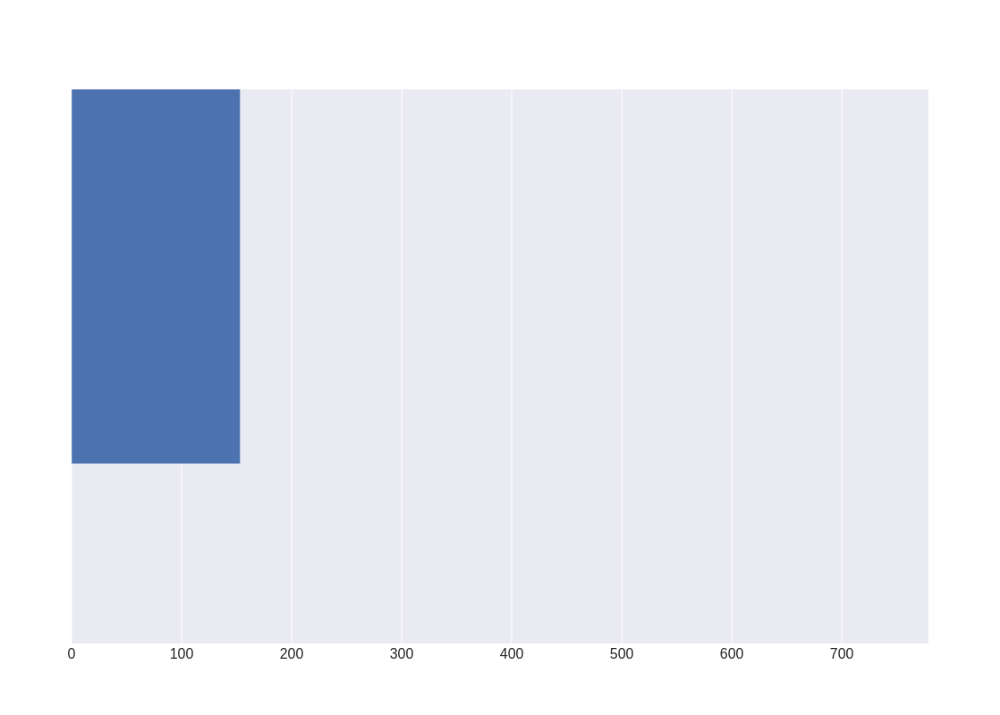

In [10]:
ordered_lg_scores = sorted(lg_scores.items(), key=lambda kv: abs(kv[1]), reverse=True)
x_lg_scores = list(map(lambda x: x[0], ordered_lg_scores))[:50][::-1]
y_lg_scores = list(map(lambda x: x[1], ordered_lg_scores))[:50][::-1]
# plt.figure(figsize=(20, 10))
# plt.barh(x_lg_scores, np.abs(y_lg_scores))

fig = go.Figure(go.Bar(
    y=x_lg_scores,
    x=np.abs(y_lg_scores),  # Use absolute values as in the original code
    orientation='h'
))

# Update layout to match the required style
fig.update_layout(
    title_font_size=32,
    title_font_family='Times New Roman',
    xaxis_title_font_size=32,
    xaxis_tickfont_size=16,
    xaxis_title_font_family='Times New Roman',
    yaxis_title_font_size=32,
    yaxis_tickfont_size=16,
    yaxis_title_font_family='Times New Roman',
    yaxis_range=[0.48, 0.85],
    width=1300,
    height=800,
    template='seaborn'
)

# Show the figure
# fig.show()



<BarContainer object of 50 artists>

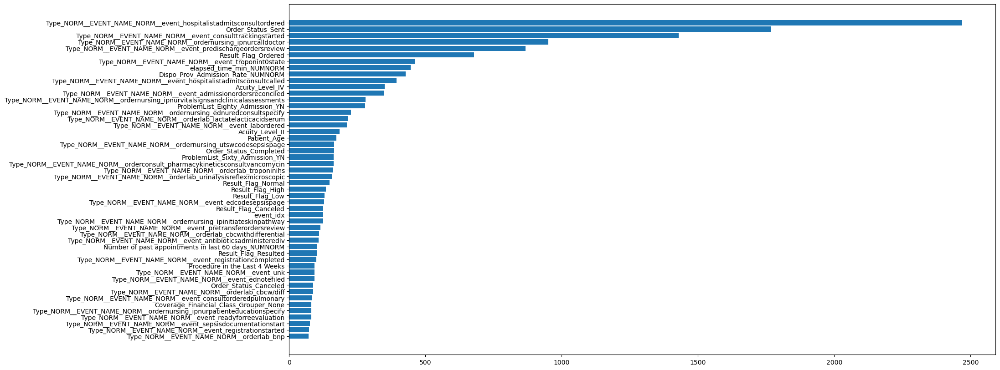

In [79]:
ordered_cat_scores = sorted(cat_scores.items(), key=lambda kv: abs(kv[1]), reverse=True)
x_cat_scores = list(map(lambda x: x[0], ordered_cat_scores))[:50][::-1]
y_cat_scores = list(map(lambda x: x[1], ordered_cat_scores))[:50][::-1]
plt.figure(figsize=(20, 10))
plt.barh(x_cat_scores, np.abs(y_cat_scores))

In [35]:
if hasattr(data['fs']['comb_model'].estimator_, 'feature_importances_'):
    cat_scores = cat_scores + pd.DataFrame(data['fs']['comb_model'].estimator_.feature_importances_, np.array(data['fs']['comb_feats'])[data['fs']['comb_model'].support_])
else:
    lg_scores = lg_scores + pd.DataFrame(data['fs']['comb_model'].estimator_.feature_importances_, np.array(data['fs']['comb_feats'])[data['fs']['comb_model'].support_])

## ML

In [25]:
ML_DIR = "/work/InternalMedicine/s223850/ED-StaticDynamic/ml_results/Clean_V1_OHE_ALL_test/"

In [26]:
ml_models = os.listdir(ML_DIR)

In [27]:
ml_models

['ml_results_30_720.joblib',
 'results_1470_1920.joblib',
 'results_750_1440.joblib']

In [28]:
with open(os.path.join(ML_DIR, ml_models[0]), 'rb') as f:
    data0 = joblib.load(f)

In [29]:
with open(os.path.join(ML_DIR, ml_models[2]), 'rb') as f:
    data1 = joblib.load(f)

In [30]:
with open(os.path.join(ML_DIR, ml_models[1]), 'rb') as f:
    data2 = joblib.load(f)

In [18]:
list(data0.keys())[0], list(data1.keys())[1], list(data2.keys())[2], list(data2.keys())[3],

('tr_2022-06-01 00:10:00_2022-11-28 23:49:00_te_2022-11-29 00:01:37_2023-05-27 23:56:00',
 'tr_2022-11-28 00:12:53_2023-05-27 23:56:00_te_2023-05-28 00:00:00_2023-11-23 23:35:00',
 'tr_2023-05-27 00:02:52_2023-11-23 23:35:00_te_2023-11-24 00:00:00_2024-05-21 23:51:00',
 'tr_2023-11-23 00:05:10_2024-05-21 23:51:00_te_2024-05-22 00:07:17_2024-05-30 23:43:00')

In [19]:
len(data0['tr_2022-06-01 00:10:00_2022-11-28 23:49:00_te_2022-11-29 00:01:37_2023-05-27 23:56:00']['lsvm_score_list'])

24

In [20]:
data0['tr_2022-06-01 00:10:00_2022-11-28 23:49:00_te_2022-11-29 00:01:37_2023-05-27 23:56:00'].keys()

dict_keys(['lsvm_score_list', 'rf_score_list', 'cat_score_list', 'lg_score_list', 'xgb_score_list', 'train_indices', 'test_indices', 'time_idx'])

In [21]:
data0['tr_2022-06-01 00:10:00_2022-11-28 23:49:00_te_2022-11-29 00:01:37_2023-05-27 23:56:00']['train_indices']

[(datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23, 49)),
 (datetime.datetime(2022, 6, 1, 0, 10),
  datetime.datetime(2022, 11, 28, 23

In [31]:
# data_models = [data0, data1, data2]
data_models = [data0, data1, data2]
main_keys = [
'tr_2022-06-01 00:10:00_2022-11-28 23:49:00_te_2022-11-29 00:01:37_2023-05-27 23:56:00',
 'tr_2022-11-28 00:12:53_2023-05-27 23:56:00_te_2023-05-28 00:00:00_2023-11-23 23:35:00',
 'tr_2023-05-27 00:02:52_2023-11-23 23:35:00_te_2023-11-24 00:00:00_2024-05-21 23:51:00',
 'tr_2023-11-23 00:05:10_2024-05-21 23:51:00_te_2024-05-22 00:07:17_2024-05-30 23:43:00'
]
models_list = ['cat_score_list', 'rf_score_list', 'lsvm_score_list', 'lg_score_list', 'xgb_score_list']
# models_list = ['cat_score_list']

all_data = []
all_auc = []
all_ppv = []
all_acc = []

for data_model in data_models:
    models_auc = []
    models_ppv = []
    models_acc = []
    models_x =[]
    for model in models_list:
        x_folds = []
        auc_folds = []
        ppv_folds = []
        acc_folds = []

        for main_key in main_keys:
            dm = data_model[main_key]
            tidx = dm['time_idx']
            model_dict_list = dm[model]
            assert(len(model_dict_list) == len(tidx)) # model_dict_list contains a model dictionary for every 30 minutes inside the ED
            x = []
            auc_scores = []
            ppv_scores = []
            acc_scores = []
            for idx, model_dict in enumerate(model_dict_list):
                x.append(tidx[idx])
                auc_scores.append(model_dict['scores']['AUC'])
                ppv_scores.append(model_dict['scores']['ppv'])
                acc_scores.append(model_dict['scores']['acc'])
            x_folds.append(x)
            auc_folds.append(auc_scores)
            ppv_folds.append(ppv_scores)
            acc_folds.append(acc_scores)
        models_x.append(x_folds)
        models_auc.append(auc_folds)
        models_ppv.append(ppv_folds)
        models_acc.append(acc_folds)

    all_data.append(models_x)
    all_auc.append(models_auc)
    all_ppv.append(models_ppv)
    all_acc.append(models_acc)

        
    # break
                

In [32]:
#           [data0][classifiers][folds][timeinED]
x = all_data[0][0][0][1]
index = ['catboost', 'randomforest', 'linearSVM', 'logisticregression', 'xgboost']
columns = ['static', 'dynamic', 'comb']
data_acc = {i: [] for i in index}
data_ppv = {i: [] for i in index}
data_auc = {i: [] for i in index}
for d in range(3):
    for ind, clc in enumerate(index):
        for ft in ['static', 'dynamic', 'comb']:
            ft_acc = []
            ft_ppv = []
            ft_auc = []
            for i in range(4):
                ft_acc.append(all_acc[d][ind][i][1][f'{ft}_te'])
                ft_ppv.append(all_ppv[d][ind][i][1][f'{ft}_te'])
                ft_auc.append(all_auc[d][ind][i][1][f'{ft}_te'])
            acc_mean = np.mean(ft_acc)
            ppv_mean = np.mean(ft_ppv)
            auc_mean = np.mean(ft_auc)
            data_acc[clc].append(acc_mean)
            data_ppv[clc].append(ppv_mean)
            data_auc[clc].append(auc_mean)
    los = all_data[d][0][0][1]
    pd.DataFrame(data_acc, index=columns).T.to_csv(f'~/Downloads/{los}_acc.csv')
    pd.DataFrame(data_ppv, index=columns).T.to_csv(f'~/Downloads/{los}_ppv.csv')
    pd.DataFrame(data_auc, index=columns).T.to_csv(f'~/Downloads/{los}_auc.csv')


ValueError: Length of values (6) does not match length of index (3)

In [33]:
# [data: int][classifier: int][folds: int][timeinED: int][feat_type: str]
class_results = {i: [] for i in ['catboost', 'randomforest', 'linearSVM', 'logisticregression', 'xgboost']}
for ind, clc in enumerate(['catboost', 'randomforest', 'linearSVM', 'logisticregression', 'xgboost']):
    acc_d = []
    ppv_d = []
    auc_d = []
    x_d = []
    for d in range(3):
        x = all_data[d][ind][0]
        acc_folds = []
        ppv_folds = []
        auc_folds = []
        for f in range(4):
            acc_folds.append(list(map(lambda x: x['comb_te'], all_acc[d][ind][f])))
            ppv_folds.append(list(map(lambda x: x['comb_te'], all_ppv[d][ind][f])))
            auc_folds.append(list(map(lambda x: x['comb_te'], all_auc[d][ind][f])))
        acc_d.extend(np.mean(acc_folds, axis=0))
        ppv_d.extend(np.mean(ppv_folds, axis=0))
        auc_d.extend(np.mean(auc_folds, axis=0))
        x_d.extend(x)
    class_results[clc].extend(auc_d)
    

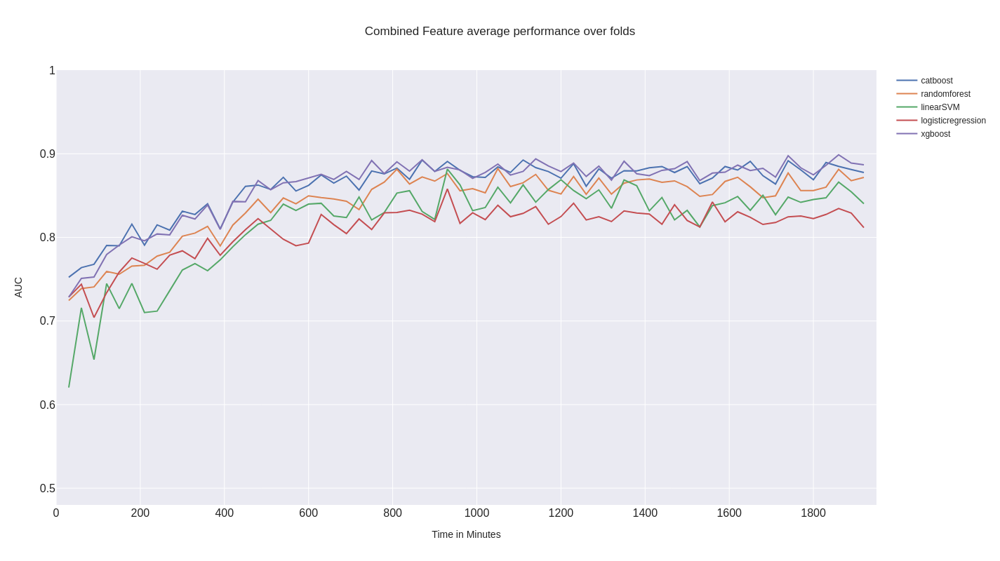

In [150]:
fig = go.Figure()
for clc, y in class_results.items():
    fig.add_traces(
        [
            go.Scatter(x=x_d, y=y, name=clc),
        ]
    )
plotly_config['yaxis_range']=[0.48, 1]
# plotly_config['xaxis_range']=[0, 1950]

fig.update_layout(
    **plotly_config,
    xaxis_title='Time in Minutes',
    yaxis_title='AUC',
    title='Combined Feature average performance over folds'
)
fig.show()

In [93]:
len(x_folds[0]), len(auc_folds[0])

(24, 24)

In [24]:
x_folds[0]

[30, 60, 90, 120, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720]

In [36]:
len(all_data[0]+all_data[1]+all_data[2]), len(all_auc[0]+all_auc[1]+all_auc[2])

(64, 64)

In [39]:
all_auc[0]+all_auc[1]+all_auc[2]

[{'static_tr': 0.8431353265145555, 'dynamic_tr': 0.770429795311778, 'comb_tr': 0.8287156719493463, 'static_te': 0.7131868131868132, 'dynamic_te': 0.6593406593406594, 'comb_te': 0.7480519480519481}, {'static_tr': 0.9059108645366301, 'dynamic_tr': 0.7229012251128666, 'comb_tr': 0.9394525804215593, 'static_te': 0.7722176079734219, 'dynamic_te': 0.7034883720930234, 'comb_te': 0.7543604651162791}, {'static_tr': 0.8273531703715856, 'dynamic_tr': 0.7747359732589615, 'comb_tr': 0.9573281519153474, 'static_te': 0.7543859649122806, 'dynamic_te': 0.6684609250398724, 'comb_te': 0.773524720893142}, {'static_tr': 0.9551726605467071, 'dynamic_tr': 0.8430833554824068, 'comb_tr': 0.9274243012819202, 'static_te': 0.7421030315878736, 'dynamic_te': 0.785244859020564, 'comb_te': 0.8135467458130168}, {'static_tr': 0.9492728985274184, 'dynamic_tr': 0.8404067786226807, 'comb_tr': 0.9559044927902471, 'static_te': 0.7617521367521367, 'dynamic_te': 0.7905982905982906, 'comb_te': 0.8002136752136753}, {'static_tr'

In [95]:
# [data: int][classifier: int][folds: int][timeinED: int][feat_type: str]
class_results = {i: [] for i in ['catboost', 'randomforest', 'linearSVM', 'logisticregression', 'xgboost']}
for ind, clc in enumerate(['catboost', 'randomforest', 'linearSVM', 'logisticregression', 'xgboost']):
    comb_d = []
    dynamic_d = []
    static_d = []
    x_d = []
    for d in range(3):
        x = all_data[d][ind][0]
        auc_comb_folds = []
        auc_dynamic_folds = []
        auc_static_folds = []
        for f in range(4):
            # acc_folds.append(list(map(lambda x: x['comb_te'], all_acc[d][ind][f])))
            # ppv_folds.append(list(map(lambda x: x['comb_te'], all_ppv[d][ind][f])))
            auc_comb_folds.append(list(map(lambda x: x['comb_te'], all_auc[d][ind][f])))
            auc_dynamic_folds.append(list(map(lambda x: x['dynamic_te'], all_auc[d][ind][f])))
            auc_static_folds.append(list(map(lambda x: x['static_te'], all_auc[d][ind][f])))
        
        comb_d.extend(np.mean(auc_comb_folds, axis=0))
        dynamic_d.extend(np.mean(auc_dynamic_folds, axis=0))
        static_d.extend(np.mean(auc_static_folds, axis=0))
        x_d.extend(x)
        
    # comb_d.extend(auc_comb_folds)
    # dynamic_d.extend(auc_dynamic_folds)
    # static_d.extend(auc_static_folds)
    break
    
# y_dynamic = list(map(lambda x: x['dynamic_te'], all_acc[0]+all_acc[1]+all_acc[2]))
# y_static = list(map(lambda x: x['static_te'], all_acc[0]+all_acc[1]+all_acc[2]))
# y_comb = list(map(lambda x: x['comb_te'], all_acc[0]+all_acc[1]+all_acc[2]))

# y_dynamic = list(map(lambda x: x['dynamic_te'], all_auc[0]+all_auc[1]+all_auc[2]))
# y_static = list(map(lambda x: x['static_te'], all_auc[0]+all_auc[1]+all_auc[2]))
# y_comb = list(map(lambda x: x['comb_te'], all_auc[0]+all_auc[1]+all_auc[2]))

# fig = go.Figure()
# fig.add_traces(
#     [
#         go.Scatter(x=x_d, y=static_d, name='static'),
#         go.Scatter(x=x_d, y=dynamic_d, name='dynamic'),
#         go.Scatter(x=x_d, y=comb_d, name='comb')
#     ]
# )
# plotly_config['yaxis_range']=[0.48, 1]
# plotly_config['xaxis_range']=[0, 1950]

# fig.update_layout(
#     **plotly_config,
#     xaxis_title='Time in Minutes',
#     yaxis_title='AUC',
#     title='Catboost AUC over Length of Stay in ED in minutes'
# )

# fig = px.line(x=x_folds[0], y=list(map(lambda x: x['dynamic_te'], auc_folds[0])))

# fig.data[0].name='fold_0'
# for i in range(1, len(x_folds)):
#     fig.add_trace(go.Scatter(x=x_folds[i], y=list(map(lambda x: x['dynamic_te'], auc_folds[i])), name=f'fold_{i}'))
    
# plotly_config['yaxis_range'] = [0.5, 0.99]
# fig.update_layout(
#     **plotly_config,
#     xaxis_title='Time in Minutes',
#     yaxis_title='AUC'
# )

In [97]:
len(comb_d), len(x_d)

(64, 64)

In [36]:
930/60

15.5

## FS+ML

In [11]:
OUTPUT_DIR = '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024'
# final_dir = os.path.join(OUTPUT_DIR, sorted(os.listdir(OUTPUT_DIR), reverse=True)[0])
final_dir_list = list(map(lambda x: os.path.join(OUTPUT_DIR, x), sorted(os.listdir(OUTPUT_DIR), reverse=True)))

In [12]:
final_dir, os.listdir(final_dir), final_dir_list

NameError: name 'final_dir' is not defined

In [52]:
fsml_dir = [folders for folders in os.listdir(OUTPUT_DIR) if 'fsml' in folders]

In [56]:
all_files = []
for fsml in fsml_dir:
    all_files.extend([f for f in os.listdir(os.path.join(OUTPUT_DIR, fsml)) if '.joblib' in f])
len(all_files)

384

In [62]:
fdl = sorted(all_files, key=lambda x: int(x.split('_')[2].split('-')[1]))
cat_tr_dict = defaultdict(list)
lg_tr_dict = defaultdict(list)
for file in fdl:
    clc = file.split('_')[0].split('-')[-1]
    tidx = file.split('_')[2].split('-')[1]
    start_tr_date = '-'.join(file.split('_')[3].split('-')[1:])
    end_tr_date = '-'.join(file.split('_')[-1].split('-')[1:]).split('.')[0]
    try:
        with open(os.path.join(OUTPUT_DIR, fsml_dir[0], file), 'rb') as f:
            data = joblib.load(f)
    except Exception as e:
        with open(os.path.join(OUTPUT_DIR, fsml_dir[1], file), 'rb') as f:
            data = joblib.load(f)
    if clc == 'cat':
        cat_tr_dict[tidx].append(data['ml']['cat']['scores']['AUC']['comb_te'])
    elif clc =='lg':
        lg_tr_dict[tidx].append(data['ml']['cat']['scores']['AUC']['comb_te'])
    else:
        print(f'Found unknown clc: {clc} ...')

In [65]:
x1 = list(map(lambda x: int(x), cat_tr_dict.keys()))
x2 = list(map(lambda x: int(x), lg_tr_dict.keys()))

len(x1), len(x2)

(64, 64)

In [99]:
x = list(map(lambda x: int(x), cat_tr_dict.keys()))
cat_y = []
lg_y = []
x_y = []
for t, dlist in cat_tr_dict.items():
    x_y.append(t)
    cat_y.append(np.mean(dlist))
    lg_y.append(np.mean(lg_tr_dict[t]))
    
# y = list(map(lambda kv: kv[1]['ml']['cat']['scores']['AUC']['comb_te'], tr_dict.items()))

In [69]:
len(cat_y), len(lg_y), len(x)

(64, 64, 64)

In [79]:
len(x_d), auc_comb_folds[19]

(64, 0.8774797102639897)

In [39]:
len(auc_comb_folds), len(x), len(comb_d)

(20, 16, 20)

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

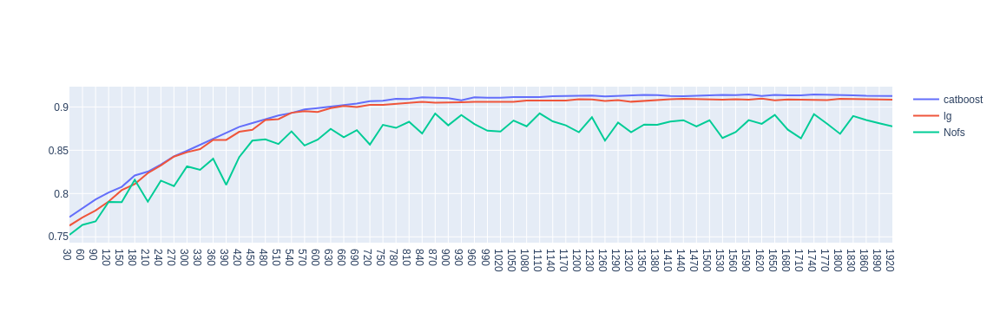

In [100]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x = x_y,
    y = cat_y,
    name='catboost'
))
fig.add_trace(go.Scatter(
    x = x_y,
    y = lg_y,
    name='lg'
))
fig.add_trace(go.Scatter(
    x = x_d,
    y = comb_d,
    name='Nofs'
))
# fig.show()

In [27]:
data['ml']['cat']['scores']['AUC']['comb_te']

0.7606811151929657

In [28]:
os.listdir(final_dir)

['fs-cat_ml_tid-30_from-2023-05-27_to-2023-11-22.joblib',
 'fs-lg_ml_tid-30_from-2023-05-27_to-2023-11-22.joblib']

# Final output format

In [10]:
import datetime as dt

In [13]:
dt.datetime.strptime("2023-05-27", "%Y-%m-%d")

datetime.datetime(2023, 5, 27, 0, 0)

In [24]:
dirs = [
    '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240916-1426-fsml',
    '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240916-1427-fsml'
]
output_filenames = sorted(os.listdir(dirs[0])+os.listdir(dirs[1]), key=lambda kv: (int(kv.split('_')[2].split('-')[1]),
                                                                dt.datetime.strptime('-'.join(kv.split('_')[3].split('-')[1:]),"%Y-%m-%d")))

In [23]:
dirsnofs = [
    '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240919-1045',
    '/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240919-1046'
]

output_filenames = sorted(os.listdir(dirsnofs[0])+os.listdir(dirsnofs[1]), key=lambda kv: (int(kv.split('_')[2].split('-')[1]),
                                                                dt.datetime.strptime('-'.join(kv.split('_')[3].split('-')[1:]),"%Y-%m-%d")))

In [27]:
output_filenames

['fs-cat_ml_tid-30_from-2022-06-01_to-2022-11-27.joblib',
 'fs-lg_ml_tid-30_from-2022-06-01_to-2022-11-27.joblib',
 'fs-cat_ml_tid-30_from-2022-11-28_to-2023-05-26.joblib',
 'fs-lg_ml_tid-30_from-2022-11-28_to-2023-05-26.joblib',
 'fs-cat_ml_tid-30_from-2023-05-27_to-2023-11-22.joblib',
 'fs-lg_ml_tid-30_from-2023-05-27_to-2023-11-22.joblib',
 'fs-lg_ml_tid-60_from-2022-06-01_to-2022-11-27.joblib',
 'fs-cat_ml_tid-60_from-2022-06-01_to-2022-11-27.joblib',
 'fs-cat_ml_tid-60_from-2022-11-28_to-2023-05-26.joblib',
 'fs-lg_ml_tid-60_from-2022-11-28_to-2023-05-26.joblib',
 'fs-lg_ml_tid-60_from-2023-05-27_to-2023-11-22.joblib',
 'fs-cat_ml_tid-60_from-2023-05-27_to-2023-11-22.joblib',
 'fs-cat_ml_tid-90_from-2022-06-01_to-2022-11-27.joblib',
 'fs-lg_ml_tid-90_from-2022-06-01_to-2022-11-27.joblib',
 'fs-cat_ml_tid-90_from-2022-11-28_to-2023-05-26.joblib',
 'fs-lg_ml_tid-90_from-2022-11-28_to-2023-05-26.joblib',
 'fs-lg_ml_tid-90_from-2023-05-27_to-2023-11-22.joblib',
 'fs-cat_ml_tid-90_from

In [65]:
def get_top_k(data, feat_type, k):
    selected_feats = np.array(data['fs'][f'{feat_type}_feats'])[data['fs'][f'{feat_type}_model'].support_]
    try:
        feats = pd.DataFrame(data['fs'][f'{feat_type}_model'].estimator_.feature_importances_, index=selected_feats, columns=['weight']).sort_values(by='weight', ascending=False).head(k).index
    except Exception as e:
        df = pd.DataFrame(data['fs'][f'{feat_type}_model'].estimator_.coef_.T, index=selected_feats, columns=['weight'])
        df['abs_weight'] = df['weight'].abs()
        df = df.sort_values(by='abs_weight', ascending=False)
        feats = df.head(k).index
    return feats

In [66]:
fs_cat_static_dict = defaultdict(dict)
fs_cat_dynamic_dict = defaultdict(dict)
fs_cat_comb_dict = defaultdict(dict)

fs_lg_static_dict = defaultdict(dict)
fs_lg_dynamic_dict = defaultdict(dict)
fs_lg_comb_dict = defaultdict(dict)
for f in output_filenames:
    fold_key = dt.datetime.strptime('-'.join(f.split('_')[3].split('-')[1:]),"%Y-%m-%d")
    tidx = int(f.split('_')[2].split('-')[1])
    try:
        with open(os.path.join(dirs[0], f), 'rb') as file:
            data = joblib.load(file)
    except Exception as e:
        with open(os.path.join(dirs[1], f), 'rb') as file:
            data = joblib.load(file)
    if 'cat' in f.split('_')[0]:
        fs_cat_comb_dict[fold_key][tidx] = get_top_k(data, 'comb', 10)
        fs_cat_static_dict[fold_key][tidx] = get_top_k(data, 'static', 10)
        fs_cat_dynamic_dict[fold_key][tidx] = get_top_k(data, 'dynamic', 10)
    else:
        fs_lg_comb_dict[fold_key][tidx] = get_top_k(data, 'comb', 10)
        fs_lg_static_dict[fold_key][tidx] = get_top_k(data, 'static', 10)
        fs_lg_dynamic_dict[fold_key][tidx] = get_top_k(data, 'dynamic', 10)


In [67]:

fs_cat_static_dict

defaultdict(dict,
            {datetime.datetime(2022, 6, 1, 0, 0): {30: Index(['Dispo_Prov_Admission_Rate_NUMNORM', 'Acuity_Level_IV', 'Patient_Age',
                     'ProblemList_Sixty_Admission_YN', 'Acuity_Level_III',
                     'ProblemList_Eighty_Admission_YN', 'Acuity_Level_II',
                     'Number of past appointments in last 60 days_NUMNORM',
                     'Number of past inpatient admissions over ED visits in last three years_NUMNORM',
                     'Means_Of_Arrival_Ambulance'],
                    dtype='object'),
              60: Index(['Dispo_Prov_Admission_Rate_NUMNORM', 'Acuity_Level_IV', 'Patient_Age',
                     'ProblemList_Sixty_Admission_YN', 'Acuity_Level_III', 'Acuity_Level_II',
                     'ProblemList_Eighty_Admission_YN',
                     'Number of past appointments in last 60 days_NUMNORM',
                     'Number of past inpatient admissions over ED visits in last three years_NUMNORM',
      

Overall Feature Selection Counts:
                                                    count
Order_Status_Sent                                     192
Result_Flag_Ordered                                   192
Type_NORM__EVENT_NAME_NORM__event_hospitalistad...    181
Type_NORM__EVENT_NAME_NORM__event_consulttracki...    178
Type_NORM__EVENT_NAME_NORM__event_predischargeo...    175
Type_NORM__EVENT_NAME_NORM__ordernursing_ipnurc...    162
Type_NORM__EVENT_NAME_NORM__event_admissionorde...    133
Type_NORM__EVENT_NAME_NORM__event_troponint0state     128
elapsed_time_min_NUMNORM                              121
Type_NORM__EVENT_NAME_NORM__event_hospitalistad...     96
Type_NORM__EVENT_NAME_NORM__ordernursing_ipnurv...     87
Type_NORM__EVENT_NAME_NORM__ordernursing_ednure...     40
Type_NORM__EVENT_NAME_NORM__ordernursing_utswco...     40
Type_NORM__EVENT_NAME_NORM__orderlab_lactatelac...     26
Result_Flag_Low                                        25
Result_Flag_High                      

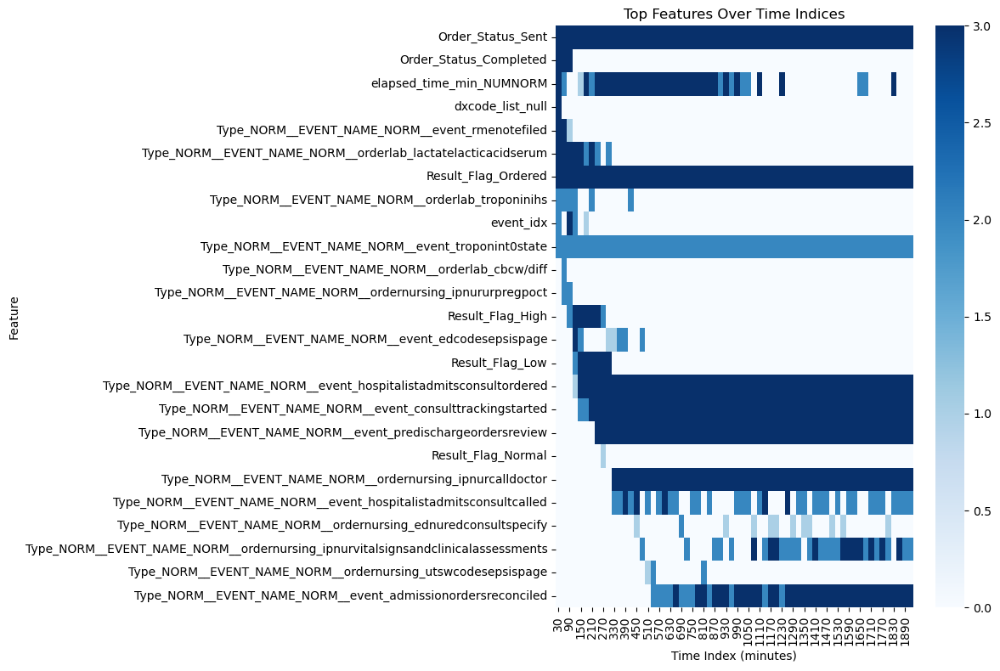

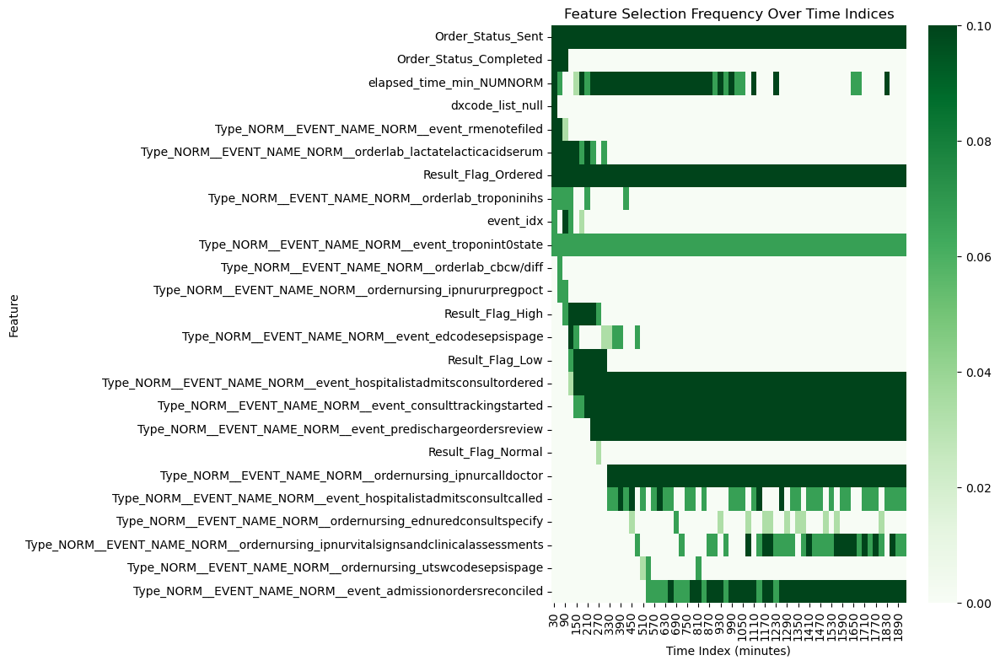


Aggregated Feature Selection Counts and Frequencies:
                                                    count  frequency
Order_Status_Sent                                     192   0.100000
Result_Flag_Ordered                                   192   0.100000
Type_NORM__EVENT_NAME_NORM__event_hospitalistad...    181   0.094271
Type_NORM__EVENT_NAME_NORM__event_consulttracki...    178   0.092708
Type_NORM__EVENT_NAME_NORM__event_predischargeo...    175   0.091146
Type_NORM__EVENT_NAME_NORM__ordernursing_ipnurc...    162   0.084375
Type_NORM__EVENT_NAME_NORM__event_admissionorde...    133   0.069271
Type_NORM__EVENT_NAME_NORM__event_troponint0state     128   0.066667
elapsed_time_min_NUMNORM                              121   0.063021
Type_NORM__EVENT_NAME_NORM__event_hospitalistad...     96   0.050000
Type_NORM__EVENT_NAME_NORM__ordernursing_ipnurv...     87   0.045312
Type_NORM__EVENT_NAME_NORM__ordernursing_ednure...     40   0.020833
Type_NORM__EVENT_NAME_NORM__ordernursing_utswco..

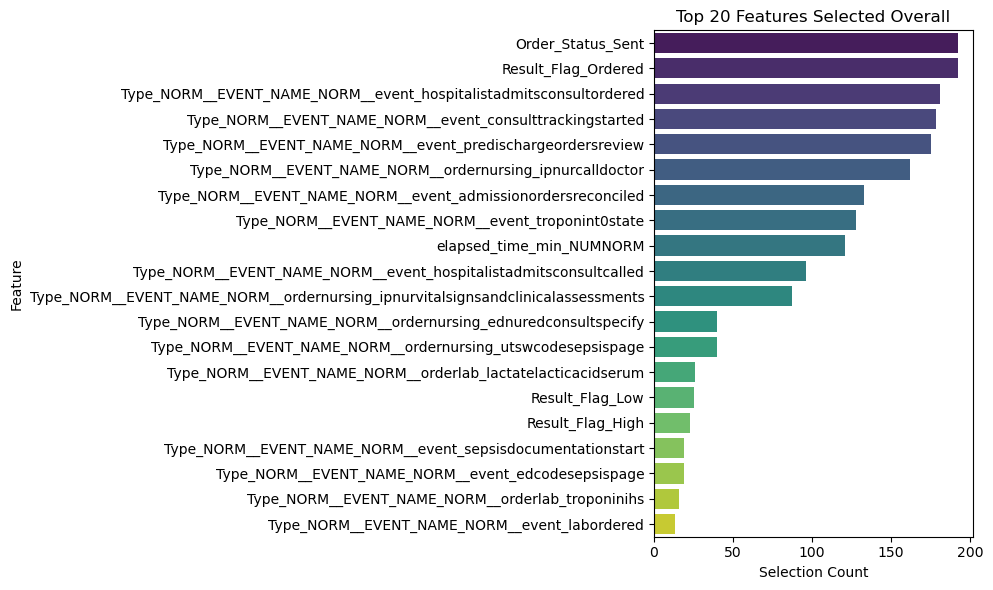

In [71]:
feature_counts = defaultdict(int)

# Also, keep track of selections per time index
feature_counts_per_time = defaultdict(lambda: defaultdict(int))

time_indices = set()
# for fold_data in fs_cat_static_dict.values():
for fold_data in fs_cat_dynamic_dict.values():
    time_indices.update(fold_data.keys())
time_indices = sorted(time_indices)

# Aggregate selected features over folds for each time index
# for fold_date, fold_data in fs_cat_static_dict.items():
for fold_date, fold_data in fs_cat_dynamic_dict.items():
    for time_idx, selected_features in fold_data.items():
        for feature in selected_features:
            # Increment overall feature count
            feature_counts[feature] += 1
            # Increment feature count for the specific time index
            feature_counts_per_time[time_idx][feature] += 1

# Create a DataFrame from feature_counts
feature_counts_df = pd.DataFrame.from_dict(feature_counts, orient='index', columns=['count'])
feature_counts_df.sort_values(by='count', ascending=False, inplace=True)

print("Overall Feature Selection Counts:")
print(feature_counts_df)

# For each time index, create a DataFrame of feature counts
for time_idx in time_indices:
    counts = feature_counts_per_time[time_idx]
    df = pd.DataFrame.from_dict(counts, orient='index', columns=['count'])
    df.sort_values(by='count', ascending=False, inplace=True)
    print(f"\nFeature Selection Counts at Time Index {time_idx}:")
    print(df)

# Visualize the top features over time
# For example, plot the top 10 features at each time index
top_k = 10
features_over_time = pd.DataFrame(index=time_indices)

for time_idx in time_indices:
    counts = feature_counts_per_time[time_idx]
    df = pd.DataFrame.from_dict(counts, orient='index', columns=['count'])
    df.sort_values(by='count', ascending=False, inplace=True)
    top_features = df.head(top_k).index
    # Fill the DataFrame with counts of top features
    for feature in top_features:
        features_over_time.loc[time_idx, feature] = df.loc[feature, 'count']

# Replace NaN with zeros
features_over_time.fillna(0, inplace=True)

# Transpose the DataFrame for plotting
features_over_time_T = features_over_time.T

# # Plot a heatmap of feature counts over time indices
# plt.figure(figsize=(12, 8))
# # sns.heatmap(features_over_time_T, annot=True, fmt=".0f", cmap='Blues')
# sns.heatmap(features_over_time_T, cmap='Blues')

# plt.title('Top Features Over Time Indices')
# plt.xlabel('Time Index (minutes)')
# plt.ylabel('Feature')
# plt.tight_layout()
# plt.show()

fig = go.Figure()

fig.add_trace(go.Heatmap(
    z=features_over_time_T.values,
    x=features_over_time_T.columns,
    y=features_over_time_T.index,
    colorscale='Blues',
    colorbar=dict(title='Selection Count', titleside='right', titlefont=dict(size=16)),
    text=features_over_time_T.values,
    texttemplate="%{text}",
    hovertemplate='Feature: %{y}<br>Time Index: %{x}<br>Count: %{z}<extra></extra>'
))

fig.update_layout(
    title='Top Features Over Time Indices',
    xaxis_title='Time Index (minutes)',
    yaxis_title='Feature',
    **plotly_config
)

fig.show()



# Additional Analysis: Frequency of Feature Selection Over Time
# Create a DataFrame to store the frequency of each feature over time indices
feature_frequency_over_time = pd.DataFrame(index=time_indices)

for time_idx in time_indices:
    total_selections = sum(feature_counts_per_time[time_idx].values())
    counts = feature_counts_per_time[time_idx]
    df = pd.DataFrame.from_dict(counts, orient='index', columns=['count'])
    df['frequency'] = df['count'] / total_selections
    df.sort_values(by='frequency', ascending=False, inplace=True)
    top_features = df.head(top_k).index
    # Fill the DataFrame with frequencies of top features
    for feature in top_features:
        feature_frequency_over_time.loc[time_idx, feature] = df.loc[feature, 'frequency']

# Replace NaN with zeros
feature_frequency_over_time.fillna(0, inplace=True)

# Transpose the DataFrame for plotting
feature_frequency_over_time_T = feature_frequency_over_time.T

# Plot a heatmap of feature frequencies over time indices
plt.figure(figsize=(12, 8))
sns.heatmap(feature_frequency_over_time_T, cmap='Greens')
# sns.heatmap(feature_frequency_over_time_T, annot=True, fmt=".2f", cmap='Greens')

plt.title('Feature Selection Frequency Over Time Indices')
plt.xlabel('Time Index (minutes)')
plt.ylabel('Feature')
plt.tight_layout()
plt.show()

# Aggregate Feature Selection Over All Time Indices
# Sum the counts across all time indices
aggregate_feature_counts = feature_counts_df.copy()
aggregate_feature_counts['frequency'] = aggregate_feature_counts['count'] / aggregate_feature_counts['count'].sum()

print("\nAggregated Feature Selection Counts and Frequencies:")
print(aggregate_feature_counts)

# Plot the top 20 features overall
top_n = 20
top_features_overall = aggregate_feature_counts.head(top_n)

plt.figure(figsize=(10, 6))
sns.barplot(x=top_features_overall['count'], y=top_features_overall.index, palette='viridis')
plt.title(f'Top {top_n} Features Selected Overall')
plt.xlabel('Selection Count')
plt.ylabel('Feature')
plt.tight_layout()
plt.show()

In [34]:
f

<_io.BufferedReader name='/work/InternalMedicine/s223850/ED-StaticDynamic/final_output_sep2024/240916-1426-fsml/fs-cat_ml_tid-30_from-2022-06-01_to-2022-11-27.joblib'>